In [ ]:
from jupyterthemes import get_themes
import jupyterthemes as jt
from jupyterthemes.stylefx import set_nb_theme
set_nb_theme('monokai')
# 'monokai', 'chesterish', 'oceans16', 'solarizedl', 'solarizedd', 'grade3', 'onedork'

In [ ]:
from jupyterthemes import get_themes
import jupyterthemes as jt
from jupyterthemes.stylefx import set_nb_theme

set_nb_theme('chesterish')
# 'monokai', 'chesterish', 'oceans16', 'solarizedl', 'solarizedd', 'grade3', 'onedork'

In [2]:
import torch
print(torch.__version__)
if torch.cuda.is_available():
    print("CUDA is available on this system.")
else:
    print("CUDA is not available on this system.")

1.12.0
CUDA is available on this system.


# <font style="color:blue">Table of Content</font>

- [Step 1: Import Libraries](#step1)
- [Step 2: Data Preparation](#step2)
- [Step 3. Train config](#step3)
- [Step 4: Training Functions](#step4)
- [Step 5: Main Function for Training](#step5)
- [Step 6. Train procedur](#step6)
- [Step 7. Make Prediction](#step7)


## <font style="color:blue">1. Import Libraries </font><a name="step1"></a>

In [3]:
# %matplotlib inline
import matplotlib.pyplot as plt
plt.style.use('ggplot')
import os
import time

from typing import Iterable
from dataclasses import dataclass
import numpy as np
import torch

import torch.nn as nn
import torch.optim as optim
import torch.nn.functional as F

from torchvision import datasets, transforms, models

from torch.optim import lr_scheduler

# <font style="color:blue">2. Train config</font><a name="step3"></a>

create the training pipeline, and train model on the full data.

### <font style="color:green">3.1. System Configuration</font>

Fix the seed (e.g., `21`) to get a reproducible result. 

In [53]:
@dataclass
class SystemConfiguration:
    '''
    Describes the common system setting needed for reproducible training
    '''
    seed: int = 21  # seed number to set the state of all random number generators
    cudnn_benchmark_enabled: bool = True  # enable CuDNN benchmark for the sake of performance
    cudnn_deterministic: bool = True  # make cudnn deterministic (reproducible training)

### <font style="color:green">3.2. Training Configuration</font>

### <font style="color:green">3.2.1 experiment 3</font>

In [28]:
@dataclass
class TrainingConfiguration:
    '''
    Describes configuration of the training process
    '''
    batch_size: int = 64  
    epochs_count: int = 45 
    init_learning_rate: float = 0.001  # initial learning rate for lr scheduler
    learning_rates = [0.001, 0.0001, 0.0001, 0.00001]
    decay_rate: float = 0.1  
    log_interval: int = 500  
    test_interval: int = 1  
    data_root: str = r'C:\Users\urial\BG\AlphaBravo\samples\samples_fixed\fixed\final_samples\data_split\train_val_change\exp2'#r"C:\Users\urial\BG\AlphaBravo\samples\samples_centered_cat" 
    num_workers: int = 0  
    device: str = 'cuda'  
    train_file: str = r'train_index_cat.txt'
    val_file: str =  r'validation_index_cat.txt'
    model_file_name: str = 'baseline_newdf_unfreeze.pt'
    mean: torch.tensor = torch.tensor([0.3670, 0.5109, 0.2689])
    std: torch.tensor = torch.tensor([0.0760, 0.0828, 0.0902])
    custom_loss: bool = False
    weights: bool=True
    get_mean_std: bool=False
        


### <font style="color:green">3.2.2 experiment 3 - expansion</font>

In [ ]:
@dataclass
class TrainingConfiguration:
    '''
    Describes configuration of the training process
    '''
    batch_size: int = 64  
    epochs_count: int = 45 
    init_learning_rate: float = 0.001  # initial learning rate for lr scheduler
    learning_rates = [0.0001, 0.00001, 0.00001, 0.000001]
    decay_rate: float = 0.1  
    log_interval: int = 500  
    test_interval: int = 1  
    data_root: str = r'C:\Users\urial\BG\AlphaBravo\samples\samples_fixed\fixed\final_samples\data_split\train_val_change\exp2'#r"C:\Users\urial\BG\AlphaBravo\samples\samples_centered_cat" 
    num_workers: int = 0  
    device: str = 'cuda'  
    train_file: str = r'train_index_cat.txt'
    val_file: str =  r'validation_index_cat.txt'
    model_file_name: str = 'baseline_newdf_unfreeze_more_ep.pt'
    mean: torch.tensor = torch.tensor([0.3670, 0.5109, 0.2689])
    std: torch.tensor = torch.tensor([0.0760, 0.0828, 0.0902])
    custom_loss: bool = False
    weights: bool=True
    get_mean_std: bool=False

### <font style="color:green">3.2.3 experiment 4 </font>

In [ ]:
@dataclass
class TrainingConfiguration:
    '''
    Describes configuration of the training process
    '''
    batch_size: int = 64  
    epochs_count: int = 55 
    init_learning_rate: float = 0.001  # initial learning rate for lr scheduler
    learning_rates = [0.0001, 0.00001, 0.000001, 0.000001]
    decay_rate: float = 0.1  
    log_interval: int = 500  
    test_interval: int = 1  
    data_root: str = r'C:\Users\urial\BG\AlphaBravo\samples\samples_fixed\fixed\final_samples\data_split\train_val_change\exp2'#r"C:\Users\urial\BG\AlphaBravo\samples\samples_centered_cat" 
    num_workers: int = 0  
    device: str = 'cuda'  
    train_file: str = r'train_index_cat.txt'
    val_file: str =  r'validation_index_cat.txt'
    model_file_name: str = 'newdf_unfreeze.pt'
    mean: torch.tensor = torch.tensor([0.3670, 0.5109, 0.2689])
    std: torch.tensor = torch.tensor([0.0760, 0.0828, 0.0902])
    custom_loss: bool = False
    weights: bool=True
    get_mean_std: bool=False


### <font style="color:green">3.2.4 experiment 4 - expansion</font>

In [54]:
@dataclass
class TrainingConfiguration:
    '''
    Describes configuration of the training process
    '''
    batch_size: int = 64  
    epochs_count: int = 55 
    init_learning_rate: float = 0.001  # initial learning rate for lr scheduler
    learning_rates = [0.0001, 0.00001, 0.000001, 0.000001]
    decay_rate: float = 0.1  
    log_interval: int = 500  
    test_interval: int = 1  
    data_root: str = r'C:\Users\urial\BG\AlphaBravo\samples\samples_fixed\fixed\final_samples\data_split\train_val_change\exp2'#r"C:\Users\urial\BG\AlphaBravo\samples\samples_centered_cat" 
    num_workers: int = 0  
    device: str = 'cuda'  
    train_file: str = r'train_index_cat.txt'
    val_file: str =  r'validation_index_cat.txt'
    model_file_name: str = 'newdf_unfreeze_expansion.pt'
    mean: torch.tensor = torch.tensor([0.3670, 0.5109, 0.2689])
    std: torch.tensor = torch.tensor([0.0760, 0.0828, 0.0902])
    custom_loss: bool = False
    weights: bool=True
    get_mean_std: bool=False


### <font style="color:green">3.3. System Setup</font>

In [55]:
def setup_system(system_config: SystemConfiguration) -> None:
    torch.manual_seed(system_config.seed)
    if torch.cuda.is_available():
        torch.backends.cudnn_benchmark_enabled = system_config.cudnn_benchmark_enabled
        torch.backends.cudnn.deterministic = system_config.cudnn_deterministic
 

## <font style="color:blue">3. Data Loaders and preparetion</font><a name="step2"></a>

### <font style="color:green">2.1. Mean and STD</font>

In [56]:
def get_mean_std(data_root,flist, num_workers=4):
    
    transform = image_preprocess_transforms()
    
    loader = data_loader(data_root,flist, transform)
    
    batch_mean = torch.zeros(3)
    batch_mean_sqrd = torch.zeros(3)
    
    for batch_data, _ in loader:
        batch_mean += batch_data.mean(dim=(0, 2, 3)) # E[batch_i] 
        batch_mean_sqrd += (batch_data ** 2).mean(dim=(0, 2, 3)) #  E[batch_i**2]
    
    # E[dataset] = E[E[batch_1], E[batch_2], ...]
    mean = batch_mean / len(loader)
    
    # var[X] = E[X**2] - E[X]**2
    
    # E[X**2] = E[E[batch_1**2] ** 2, E[batch_2**2] ** 2, ...]
    # E[X]**2 = E[E[batch_1], E[batch_2], ...]
    
    var = (batch_mean_sqrd / len(loader)) - (mean ** 2)
        
    std = var ** 0.5
    print('mean: {}, std: {}'.format(mean, std))
    
    return mean, std

# file_path = os.path.join(TrainingConfiguration.data_root,r'table_data\final\seven\outlier\improved\train_PC_ver2.txt')
# mean,std = get_mean_std(TrainingConfiguration.data_root,file_path)
# mean=torch.tensor([0.3623, 0.5088, 0.2704])previous
# std = torch.tensor([0.0781, 0.0863, 0.0913])
#new dataframe
# mean: tensor([0.3617, 0.5077, 0.2707]), std: tensor([0.0787, 0.0856, 0.0918])

### <font style="color:green">2.2. Image Transforms</font>

In [57]:

# Image Transforms
def image_preprocess_transforms():
    preprocess = transforms.Compose([
        transforms.Resize(256),
        transforms.CenterCrop(224),
        transforms.ToTensor()
        ])
    
#     return preprocess
    return preprocess  # Send to GPU

def image_common_transforms(mean=None, std=None):
    mean=TrainingConfiguration.mean 
    std = TrainingConfiguration.std
    preprocess = image_preprocess_transforms()
    
    common_transforms = transforms.Compose([
        preprocess,
        transforms.Normalize(mean, std)
    ])
    
#     return common_transforms
    return common_transforms  # Send to GPU
    
def data_augmentation_preprocess(mean=None, std=None):
    mean=TrainingConfiguration.mean 
    std = TrainingConfiguration.std
    initail_transoform = transforms.RandomChoice([
        transforms.RandomHorizontalFlip(),
        transforms.RandomVerticalFlip(),
        transforms.RandomRotation(45)
        ])
    
    common_transforms = image_common_transforms(mean, std)
                
    aug_transforms = transforms.Compose([
        initail_transoform,
#         transforms.RandomGrayscale(p=0.1),
        common_transforms
        ])
    
#     return aug_transforms
    return aug_transforms  # Send to GPU

### <font style="color:green">2.4 Data Loader for Full Data</font>
Data loader for generating batches of data to be used by the training routine

In [58]:
import torch.utils.data as data
import torch
from PIL import Image
import os
import os.path
from torchvision import transforms
def default_loader(path):
    return Image.open(path).convert('RGB')

def default_flist_reader(flist):
    """
    flist format: impath label\nimpath label\n ...(same to caffe's filelist)
    """
    imlist = []
    with open(flist, 'r') as rf:
        for line in rf.readlines():
            impath, imlabel = line.strip().split()[0],torch.tensor(int(line.strip().split()[1].split('_')[0]))
            imlist.append( (impath, imlabel) )

    return imlist

class ImageFilelist(data.Dataset):
    def __init__(self, root, flist, transform=None, target_transform=None,
            flist_reader=default_flist_reader, loader=default_loader):
        self.root   = root
        self.imlist = flist_reader(flist)
        self.transform = transform#transforms.Compose([transforms.ToTensor()])
        self.target_transform = target_transform
        self.loader = loader

    def __getitem__(self, index):
        impath, target = self.imlist[index]
        img = self.loader(os.path.join(self.root,impath))
        if self.transform is not None:
            img = self.transform(img)
        if self.target_transform is not None:
            target = self.target_transform(target)

        return img, target

    def __len__(self):
        return len(self.imlist)
    


In [59]:
from sklearn.utils import compute_class_weight
from torch.utils.data import WeightedRandomSampler, DataLoader
def data_loader(data_root,flist, transform, batch_size=TrainingConfiguration.batch_size, shuffle=True, num_workers=0,pin_memory=True,weights=None):
#     batch_size=TrainingConfiguration.batch_size if batch_size is not None else batch_size
#     dataset = datasets.ImageFolder(root=data_root, transform=transform)
   
    weights = TrainingConfiguration.weights if weights is None else weights
    dataset = ImageFilelist(root=data_root, flist=flist,transform=transform)
    
    if weights:
        print('computing weights')
        class_weights = compute_weights(data_root, flist)
#         print(class_weights)
        sample_weights = [0] * len(dataset)

        for idx, (data, label) in enumerate(dataset):
            class_weight = class_weights[label]
            sample_weights[idx] = class_weight
        
        sampler = WeightedRandomSampler(
            sample_weights, num_samples=len(sample_weights), replacement=True)
        
    sampler_ = sampler if weights else None
#     print(sampler_)
    loader = torch.utils.data.DataLoader(dataset, 
                                         batch_size=batch_size,
                                         num_workers=num_workers,
                                         pin_memory=pin_memory,sampler=sampler_,shuffle=shuffle)
    
    return loader


In [60]:
 def compute_weights(data_root, flist):
    output = default_flist_reader(flist)
    imlist, labels= zip(*output)
    labels = torch.tensor([label.item() for label in labels])
    labels_np = np.array(labels)
    class_weights = compute_class_weight('balanced', classes=np.unique(labels_np), y=labels_np)
    print(f'class_weights:{class_weights}')
    return class_weights
def data_loader(data_root, flist, transform, batch_size=TrainingConfiguration.batch_size, shuffle=True, num_workers=0, pin_memory=True, weights=None):
#     batch_size = TrainingConfiguration.batch_size if batch_size is None else batch_size
    dataset = ImageFilelist(root=data_root, flist=flist, transform=transform)
#     weights = TrainingConfiguration.weights if weights is None else weights
    if weights:
        print('computing weights')
        class_weights = compute_weights(data_root, flist)
        sample_weights = [0] * len(dataset)

        for idx, (data, label) in enumerate(dataset):
            class_weight = class_weights[label]
            sample_weights[idx] = class_weight

        sampler = WeightedRandomSampler(
            sample_weights, num_samples=len(sample_weights), replacement=True)
        shuffle = False  # Disable shuffling when using weighted sampler

    else:
        sampler = None

    loader = torch.utils.data.DataLoader(dataset,
                                         batch_size=batch_size,
                                         num_workers=num_workers,
                                         pin_memory=pin_memory,
                                         sampler=sampler,
                                         shuffle=shuffle)

    return loader



## <font style="color:green">2.5. Prepare Data</font>
The main function which uses all the above functions to generate the train and test dataloaders.


In [61]:
#added name of files 'train_txt_new.txt' 'validation_txt_new.txt'
def get_data(batch_size, data_root, num_workers=4, data_augmentation=False,
             train_f=None,val_f=None):#,val_f = 'validation_txt.txt'):
    device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
    # =r'table_data\final\seven\train_original.txt' r'table_data\final\seven\outlier\test_original.txt'
    train_f = TrainingConfiguration.train_file if train_f is None else train_f
    val_f = TrainingConfiguration.val_file if val_f is None else val_f
    train_data_list_file = os.path.join(data_root, train_f)
    batch_size = TrainingConfiguration.batch_size
    if TrainingConfiguration.get_mean_std:
        mean, std = get_mean_std(data_root,train_data_list_file)
        TrainingConfiguration(mean=mean,std=std)
    else:
        mean=TrainingConfiguration.mean 
        std = TrainingConfiguration.std
        
    common_transforms = image_common_transforms(mean, std)
    # Move common_transforms to GPU
    common_transforms = common_transforms
   
    # if data_augmentation is true 
    # data augmentation implementation
    if data_augmentation:    
        train_transforms = data_augmentation_preprocess(mean, std)
    # else do common transforms
    else:
        train_transforms = common_transforms
        
    # Move train_transforms to GPU
    train_transforms = train_transforms
    # train dataloader
    
    train_loader = data_loader(data_root,train_data_list_file, 
                               train_transforms, 
                               batch_size=batch_size, 
                               shuffle=True, 
                               num_workers=num_workers)
    
    # test dataloader
    
    test_data_path = os.path.join(data_root,val_f )
    
    test_loader = data_loader(data_root,test_data_path, 
                              common_transforms, 
                              batch_size=batch_size, 
                              shuffle=False, 
                              num_workers=num_workers,weights=False)
    
#     # test dataloader
    
#     testdata = datasets.ImageFolder(root=test_data_path, transform=common_transforms)
    
    return train_loader, test_loader

## <font style="color:blue">4. Training Functions</font><a name="step4"></a>



### <font style="color:green">4.1. Train function</font>

In [62]:
def train(
    train_config: TrainingConfiguration, model: nn.Module, optimizer: torch.optim.Optimizer,
    train_loader: torch.utils.data.DataLoader, epoch_idx: int,criterion = None) -> None:
    
    # change model in training mood
    model.train()
    
    # Create the loss criterion
    criterion = nn.CrossEntropyLoss() if criterion is None else criterion
    
    # to get batch loss
    batch_loss = np.array([])
    
    # to get batch accuracy
    batch_acc = np.array([])

    for batch_idx, (data, target) in enumerate(train_loader):
        
        # clone target
        indx_target = target.clone()
        # send data to device (its is medatory if GPU has to be used)
        data = data.to(train_config.device)
        # send target to device
        target = target.to(train_config.device)

        # reset parameters gradient to zero
        optimizer.zero_grad()
        
        # forward pass to the model
        output = model(data)
        # Convert custom output to tensor if it is a float
        if isinstance(output, float):
            output = torch.tensor(output, device=train_config.device)
        #weight = torch.tensor([1.7302, 2.9838, 1.2069, 1.0000, 1.8388, 3.8024, 4.4448],device='cuda')
        loss =criterion(output, target)# ,weight=weight)# F.cross_entropy(output, target) 
        
        
#         for name, param in model.named_parameters():
#             if param.grad is not None:
#                 print(f'Parameter: {name}, Gradient norm: {torch.norm(param.grad)}')
                
        # find gradients w.r.t training parameters
        loss.backward()

        # Update parameters using gardients
        optimizer.step()
        
        batch_loss = np.append(batch_loss, [loss.item()])
        
        # Score to probability using softmax
        prob = output#F.softmax(output, dim=1)
            
        # get the index of the max probability
        pred = prob.data.max(dim=1)[1]  
                        
        # correct prediction
        correct = pred.cpu().eq(indx_target).sum()
            
        # accuracy
        acc = float(correct) / float(len(data))
        
        batch_acc = np.append(batch_acc, [acc])
            
    epoch_loss = batch_loss.mean()
    epoch_acc = batch_acc.mean()
    print('Epoch: {} \nTrain Loss: {:.6f} Acc: {:.4f}'.format(epoch_idx, epoch_loss, epoch_acc))
    return epoch_loss, epoch_acc

### <font style="color:green">4.1. Train functions - unfreeze and debug</font>

In [63]:
def train_unfreeze(
    train_config: TrainingConfiguration, model: nn.Module, optimizer: torch.optim.Optimizer,
    train_loader: torch.utils.data.DataLoader, epoch_idx: int,criterion = None) -> None:
    
    # change model in training mood
    model.train()
    
    # Create the loss criterion
    criterion = nn.CrossEntropyLoss() if criterion is None else criterion
    
    # to get batch loss
    batch_loss = np.array([])
    
    # to get batch accuracy
    batch_acc = np.array([])
    layers = ['fc','layer4','layer3','layer2']
    set_idx = int(np.floor(epoch_idx/10))
    unfreeze_layers = layers[:set_idx+1]
    print(f'set_idx:{set_idx},epoch_idx:{epoch_idx}')
    for layer_name in unfreeze_layers:
        print(f'unfreeze: {layer_name}')
        layer = getattr(model, layer_name)
        for param in layer.parameters():
            param.requires_grad = True
#         for param in model.layer_name.parameters():
#             param.requires_grad = True

        

    for batch_idx, (data, target) in enumerate(train_loader):
        
        # clone target
        indx_target = target.clone()
        # send data to device (its is medatory if GPU has to be used)
        data = data.to(train_config.device)
        # send target to device
        target = target.to(train_config.device)

        # reset parameters gradient to zero
        optimizer.zero_grad()
        
        # forward pass to the model
        output = model(data)

        loss =criterion(output, target)# ,weight=weight)# F.cross_entropy(output, target) 
        
        
#         for name, param in model.named_parameters():
#             if param.grad is not None:
#                 print(f'Parameter: {name}, Gradient norm: {torch.norm(param.grad)}')
                
        # find gradients w.r.t training parameters
        loss.backward()
        
        # Update parameters using gardients
        optimizer.step()
        
        batch_loss = np.append(batch_loss, [loss.item()])
        
        # Score to probability using softmax
        prob = F.softmax(output, dim=1)
            
        # get the index of the max probability
        pred = prob.data.max(dim=1)[1]  
                        
        # correct prediction
        correct = pred.cpu().eq(indx_target).sum()
            
        # accuracy
        acc = float(correct) / float(len(data))
        
        batch_acc = np.append(batch_acc, [acc])
            
    epoch_loss = batch_loss.mean()
    epoch_acc = batch_acc.mean()
    print('Epoch: {} \nTrain Loss: {:.6f} Acc: {:.4f}'.format(epoch_idx, epoch_loss, epoch_acc))
    return epoch_loss, epoch_acc


### <font style="color:green">4.2. Validation Function</font>

In [64]:
def validate(
    train_config: TrainingConfiguration,
    model: nn.Module,
    test_loader: torch.utils.data.DataLoader,
    criterion=None
) -> float:
    model.eval()
    test_loss = 0
    count_correct_predictions = 0
    criterion = nn.CrossEntropyLoss() if criterion is None else criterion
    with torch.no_grad():
        for data, target in test_loader:
            input_size = data.size()
            target_size = target.size()

#             print("Input size:", input_size)
#             print("Target size:", target_size)
            
            indx_target = target.clone()
            data = data.to(train_config.device)
            target = target.to(train_config.device)
            output = model(data)
            loss = criterion(output, target)
            if torch.isnan(loss):
                print(f'model output:{output}')
                print("NaN loss encountered:")
#                 print("Input:", data)
#                 print("Target:", target)
            test_loss += loss.item()
            prob = output#F.softmax(output, dim=1)
            pred = prob.data.max(dim=1)[1]
            count_correct_predictions += pred.cpu().eq(indx_target).sum()

    test_loss = test_loss / len(test_loader)
    accuracy = 100. * count_correct_predictions / len(test_loader.dataset)

    print(
        'Test set: Average loss: {:.4f}, Accuracy: {}/{} ({:.0f}%)'.format(
            test_loss, count_correct_predictions, len(test_loader.dataset), accuracy
        )
    )

    return test_loss, accuracy / 100.0


### <font style="color:green">4.3. Save and load Model</font>

In [65]:
def save_model(model, device, model_dir='models',model_file_name=None):
    model_file_name=TrainingConfiguration.model_file_name if model_file_name is None else model_file_name
    if not os.path.exists(model_dir):
        os.makedirs(model_dir)

    model_path = os.path.join(model_dir, model_file_name)

    # make sure you transfer the model to cpu.
    if device == 'cuda':
        model.to('cpu')

    # save the state_dict
    torch.save(model.state_dict(), model_path)
    
    if device == 'cuda':
        model.to('cuda')
    
    return

def load_model(model, model_dir='models', model_file_name='UI_unfreeze_aug.pt'):
    model_path = os.path.join(model_dir, model_file_name)

    # loading the model and getting model parameters by using load_state_dict
    model.load_state_dict(torch.load(model_path))
    
    return model

## <font style="color:blue">5. Main Function for Training</font><a name="step5"></a>

Note: Before calling the train function, we calculate the validation loss, which we know should be close to $\log(\text{num_classes})$. Also, the accuracy should be close to $\frac{1}{\text{num_classes}}$.

### <font style="color:green">5.1. Main</font>

In [66]:
def main(model, optimizer, scheduler=None, system_configuration=SystemConfiguration(), 
         training_configuration=TrainingConfiguration(),
         data_augmentation=False, mean=None, std=None, criterion=None):
    
    # system configuration
    setup_system(system_configuration)

    # batch size
    batch_size_to_set = training_configuration.batch_size
    # num_workers
    num_workers_to_set = training_configuration.num_workers
    # epochs
    epoch_num_to_set = training_configuration.epochs_count

    # if GPU is available use training config, 
    # else lowers batch_size, num_workers and epochs count
    # Check GPU availability
    if torch.cuda.is_available():
        device = torch.device("cuda")
        print("Using CUDA")
    else:
        device = torch.device("cpu")
        print("Using CPU")
        batch_size_to_set = 32
        num_workers_to_set = 0
    # Update training configuration
    training_configuration.device = device
    training_configuration.batch_size = batch_size_to_set
    training_configuration.num_workers = num_workers_to_set
    
    # data loader
    train_loader, test_loader = get_data(
        batch_size=batch_size_to_set,
        data_root=training_configuration.data_root,
        num_workers=num_workers_to_set,
        data_augmentation=data_augmentation
    )
    
    # send model to device (GPU/CPU)
    model.to(training_configuration.device)

    best_loss = torch.tensor(np.inf)
    
    # epoch train/test loss
    epoch_train_loss = np.array([])
    epoch_test_loss = np.array([])
    
    # epch train/test accuracy
    epoch_train_acc = np.array([])
    epoch_test_acc = np.array([])
    
    # Calculate Initial Test Loss
    init_val_loss, init_val_accuracy = validate(training_configuration, model, test_loader,
                                               criterion=criterion)
    print("Initial Test Loss : {:.6f}, \nInitial Test Accuracy : {:.3f}%\n".format(init_val_loss, 
                                                                                   init_val_accuracy*100))
    
    # trainig time measurement
    t_begin = time.time()
    for epoch in range(training_configuration.epochs_count):
#         optimizer, scheduler = get_optimizer_and_scheduler(model)
        # Train
        train_loss, train_acc = train_unfreeze(training_configuration, model, optimizer, train_loader, epoch,
                                     criterion=criterion)
        
        epoch_train_loss = np.append(epoch_train_loss, [train_loss])
        
        epoch_train_acc = np.append(epoch_train_acc, [train_acc])

        elapsed_time = time.time() - t_begin
        speed_epoch = elapsed_time / (epoch + 1)
        speed_batch = speed_epoch / len(train_loader)
        eta = speed_epoch * training_configuration.epochs_count - elapsed_time
        set_idx = int(np.floor(epoch/10))
        
#         optimizer_state_layer = [optimizer.param_groups[i]['lr'] for i in range(set_idx+1)] 
#         optimizer_value_before = optimizer.state_dict()['param_groups'][set_idx]['lr']
#         print(f'optimizer_value_before:{optimizer_value_before}\noptimizer_state_layer: {optimizer_state_layer}\n')
#         [optimizer.load_state_dict(optimizer_state_layer[i]) for i,optimizer in enumerate(optimizers[0:set_idx+1])]
#         for i in range(set_idx+1):
#             optimizer.param_groups[i]['lr'] = optimizer_state_layer[i]
            
        print(
            "Elapsed {:.2f}s, {:.2f} s/epoch, {:.2f} s/batch, ets {:.2f}s".format(
                elapsed_time, speed_epoch, speed_batch, eta
            )
        )

        # Validate
        if epoch % training_configuration.test_interval == 0:
            current_loss, current_accuracy = validate(training_configuration, model, test_loader)
            
            epoch_test_loss = np.append(epoch_test_loss, [current_loss])
        
            epoch_test_acc = np.append(epoch_test_acc, [current_accuracy])
            
            if current_loss < best_loss: 
                best_loss = current_loss
                print('Model Improved. Saving the Model...\n')
                save_model(model, device=training_configuration.device)
        
                
    print("Total time: {:.2f}, Best Loss: {:.3f}".format(time.time() - t_begin, best_loss))
    
    return model, epoch_train_loss, epoch_train_acc, epoch_test_loss, epoch_test_acc

### <font style="color:green">5.2. Plot Loss and Accuracy</font>

In [67]:
def plot_loss_accuracy(train_loss, val_loss, train_acc, val_acc, colors=['blue'], 
                       loss_legend_loc='upper center', acc_legend_loc='upper left', 
                       fig_size=(20, 10), sub_plot1=(1, 2, 1), sub_plot2=(1, 2, 2)):
    
    plt.rcParams["figure.figsize"] = fig_size
    fig = plt.figure()
    
    plt.subplot(sub_plot1[0], sub_plot1[1], sub_plot1[2])
    
    for i in range(len(train_loss)):
        x_train = range(len(train_loss[i]))
        x_val = range(len(val_loss[i]))
        
        min_train_loss = train_loss[i].min()
        
        min_val_loss = val_loss[i].min()
        
        plt.plot(x_train, train_loss[i], linestyle='-', color='tab:{}'.format(colors[i]), 
                 label="TRAIN LOSS ({0:.4})".format(min_train_loss))
        plt.plot(x_val, val_loss[i], linestyle='--' , color='tab:{}'.format(colors[i]), 
                 label="VALID LOSS ({0:.4})".format(min_val_loss))
        
    plt.xlabel('epoch no.')
    plt.ylabel('loss')
    plt.legend(loc=loss_legend_loc)
    plt.title('Training and Validation Loss')
        
    plt.subplot(sub_plot2[0], sub_plot2[1], sub_plot2[2])
    
    for i in range(len(train_acc)):
        x_train = range(len(train_acc[i]))
        x_val = range(len(val_acc[i]))
        
        max_train_acc = train_acc[i].max() 
        
        max_val_acc = val_acc[i].max() 
        
        plt.plot(x_train, train_acc[i], linestyle='-', color='tab:{}'.format(colors[i]), 
                 label="TRAIN ACC ({0:.4})".format(max_train_acc))
        plt.plot(x_val, val_acc[i], linestyle='--' , color='tab:{}'.format(colors[i]), 
                 label="VALID ACC ({0:.4})".format(max_val_acc))
        
    plt.xlabel('epoch no.')
    plt.ylabel('accuracy')
    plt.legend(loc=acc_legend_loc)
    plt.title('Training and Validation Accuracy')
    
    fig.savefig('sample_loss_acc_plot.png')
    plt.show()
    
    return   

### <font style="color:green">5.3. Optimizer and schedualer</font>

In [68]:
def get_optimizer_and_scheduler(model,schedul = 'Plateau'):
    train_config = TrainingConfiguration()

    init_learning_rate = train_config.init_learning_rate
    learning_rate= train_config.learning_rate
    
    # optimizer
    optimizer = optim.Adam(
        model.parameters(),
        lr=train_config.learning_rate)
    if schedul=='Plateau':
        
        factor = 0.5  # reduce by factor 0.5
        patience = 4  # epochs
        threshold = 0.01
        verbose = True

        scheduler = lr_scheduler.ReduceLROnPlateau(optimizer,
                                                   factor=factor,
                                                   patience=patience,
                                                   verbose=verbose, threshold=threshold)
    else:
        decay_rate = train_config.decay_rate

        lmbda = lambda epoch: 1/(1 + decay_rate * epoch)

        # Scheduler
        scheduler = lr_scheduler.LambdaLR(optimizer, lr_lambda=lmbda)

    return optimizer, scheduler

    # optimizer"
#     optimizer = optim.SGD(
#         model.parameters(),
#         lr = init_learning_rate,
#         momentum = 0.9
#     )

## <font style="color:blue">6. metrics</font><a name="step6"></a>

### <font style="color:orange">6.1 confusion matrix</font><a name="step6"></a>

In [69]:
from sklearn.metrics import f1_score
import itertools

import numpy as np
import matplotlib.pyplot as plt

def con(model,data_path,file_path,size,mean, std):#train_data_path/test_data_path
    
#     device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")
    device = "cpu"
    batch_size = 32
    num_workers = 4
    if torch.cuda.is_available():
        device = "cuda:0"
        batch_size = 64
        num_workers = 0

        
        
#     device = 'cpu'
    model = model.to(device)
    @torch.no_grad()
    def get_all_preds(model,loader ):
        all_preds = torch.tensor([])
        all_labels = torch.tensor([])
        
        all_preds, all_labels = all_preds.to(device), all_labels.to(device)#added
        
        for batch in loader:
            images, labels = batch
            
            images, labels = images.to(device), labels.to(device)#added
            
            preds = model(images)
            
            preds = preds.to(device)#added
            
            all_preds = torch.cat(
                (all_preds, preds)
                ,dim=0
            )
            all_labels = torch.cat(
                (all_labels, labels)
                ,dim=0
            )
        return all_preds,all_labels

    def extract_data(model,data_path):
        with torch.no_grad():
            test_data_path = os.path.join(data_path,file_path)#'validation_txt.txt')
            #r'table_data/final/seven/outlier/test_original.txt'
            test_loader = data_loader(data_path,test_data_path, 
                                      image_common_transforms(), 
                                      batch_size=batch_size, 
                                      shuffle=True, 
                                      num_workers=num_workers)

            all_preds,all_labels = get_all_preds(model, test_loader)
            return all_preds,all_labels
    def get_num_correct(all_preds,all_labels):
        preds_correct = all_preds.argmax(dim=1).eq(all_labels).sum().item()
        print('total correct:', preds_correct)
        print('accuracy:', preds_correct / len(all_labels))
     
    def matrix(size,all_preds,all_labels):
        stacked = torch.stack((all_labels,all_preds.argmax(dim=1)),dim=1)
        stacked[0].tolist()
        cmt = torch.zeros(size,size, dtype=torch.int64)
        for p in stacked:
            tl, pl = p.tolist()
            tl, pl = int(tl), int(pl)
            cmt[tl, pl] = cmt[tl, pl] + 1
        return cmt


    all_preds,all_labels = extract_data(model,data_path)
#     print('F1-Score macro: ',f1_score(all_preds.cpu(), all_labels.cpu(), average='macro'))
#     print('F1-Score micro: ',f1_score(all_preds.cpu(), all_labels.cpu(), average='micro'))
    get_num_correct(all_preds,all_labels)
    cmt = matrix(size,all_preds.cpu(),all_labels.cpu())
    
    return cmt,all_preds,all_labels



def plot_confusion_matrix(cm, classes=None, normalize=False, title='Confusion matrix', cmap=plt.cm.Blues,ranges=1):
    if classes is None:
        original = ['0_5','6-15','16-30','31-50','51-70','71-90','91-above']
        modified = ['0-5','6-20','21-32','33-50','51-70','71-100','101-above']
        ranges= original if ranges==1 else modified 
        classes ={range:i for i,range in enumerate(ranges)}
        print(classes)
    if normalize:
        cm = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]
        print("Normalized confusion matrix")
    else:
        print('Confusion matrix, without normalization')

    print(cm)
    plt.figure(figsize=(10,8))
    plt.imshow(cm, interpolation='nearest', cmap=cmap)
    plt.title(title)
    plt.colorbar()
    tick_marks = np.arange(len(ranges))
    plt.xticks(tick_marks, classes, rotation=45)
    plt.yticks(tick_marks, classes)

    fmt = '.2f' if normalize else 'd'
    thresh = cm.max() / 2.
    for i, j in itertools.product(range(cm.shape[0]), range(cm.shape[1])):
        plt.text(j, i, format(cm[i, j], fmt), horizontalalignment="center", color="white" if cm[i, j] > thresh else "black")

    plt.tight_layout()
    plt.ylabel('True label')
    plt.xlabel('Predicted label')
    


### <font style="color:green">6.2 metrics scores and roc curve</font><a name="step6"></a>

In [70]:
import torch
import numpy as np
from torchmetrics import Accuracy, Precision, Recall
from sklearn.metrics import precision_score, recall_score, f1_score
from sklearn.metrics import roc_curve, roc_auc_score
import matplotlib.pyplot as plt

def plot_metrics(cm, all_preds, all_labels,num_classes=7):
    preds = all_preds.cpu().argmax(dim=1)
    target = torch.from_numpy(np.array(all_labels.cpu(), dtype=np.int64))  # Convert target to a PyTorch tensor
    
#     num_classes = 7  # Specify the number of classes
    
    accuracy = Accuracy(average='macro', num_classes=num_classes, task='multiclass')
    precision = Precision(average='macro', num_classes=num_classes, task='multiclass')
    recall = Recall(average='macro', num_classes=num_classes, task='multiclass')
    
    accuracy_value = accuracy(preds, target)
    precision_value = precision(preds, target)
    recall_value = recall(preds, target)
    f1_macro = f1_score(target.numpy(), preds, average='macro')
    
    print(f'Accuracy: {accuracy_value:.4f}')
    print(f'Precision: {precision_value:.4f}')
    print(f'Recall: {recall_value:.4f}')
    print(f'F1-Score (macro): {f1_macro:.4f}')



def plot_roc_curve(all_preds, all_labels,m):
    preds_proba = all_preds.cpu().softmax(dim=1)  # Calculate predicted probabilities
    target = all_labels.cpu().numpy()  # Convert target to numpy array

    # Calculate TPR and FPR
    fpr, tpr, thresholds = roc_curve(target, preds_proba[:, 1], pos_label=1)
    
    # Calculate AUC
    auc = roc_auc_score(target, preds_proba, multi_class=m)
    
    # Plot ROC curve
    plt.plot(fpr, tpr, label='ROC curve (AUC = {:.2f})'.format(auc))
    plt.plot([0, 1], [0, 1], 'k--')  # Plot diagonal line for random classifier
    plt.xlabel('False Positive Rate')
    plt.ylabel('True Positive Rate')
    plt.title('Receiver Operating Characteristic (ROC) Curve')
    plt.legend(loc='lower right')
    plt.show()

In [ ]:
import numpy as np
import matplotlib.pyplot as plt


def matrix_plot(confusion_matrix):
    columns = ['0_5', '5-15', '15-30', '30-40', '40-50', '50-70', '70-90', '90-110', '110-above']

    plt.figure(figsize=(15, 14))

    # Customize the size of each score
    confusion_matrix_normalized = confusion_matrix / confusion_matrix.sum(axis=1, keepdims=True)
    confusion_matrix_normalized *= 100  # Normalize to percentage
    cell_sizes = confusion_matrix_normalized.flatten()

    # Create a colormap based on values
    cmap = plt.cm.Blues
    norm = plt.Normalize(vmin=0, vmax=100)

    # Plot the confusion matrix grid
    plt.imshow(confusion_matrix_normalized, cmap=cmap, norm=norm)

    # Add text labels in each cell (only if the value is greater than 0)
    for i in range(confusion_matrix.shape[0]):
        for j in range(confusion_matrix.shape[1]):
            value = int(round(confusion_matrix_normalized[i, j]))
            if value > 0:
                 plt.text(j, i, f'{confusion_matrix[i, j]}\n({confusion_matrix_normalized[i, j]:.0f}%)',
                     ha="center", va="center", color="w" if confusion_matrix_normalized[i, j] > 50 else "k",
                     fontsize=cell_sizes[i * confusion_matrix.shape[1] + j] / 10 + 10)
            else:

                 plt.text(j, i, f'{confusion_matrix[i, j]}',
                     ha="center", va="center", color="w" if confusion_matrix_normalized[i, j] > 50 else "k",
                     fontsize=cell_sizes[i * confusion_matrix.shape[1] + j] / 10 + 10)

    plt.xticks(np.arange(len(columns)), columns, rotation=45, fontsize=12)
    plt.yticks(np.arange(len(columns)), columns, fontsize=12)

    plt.xlabel("Predicted", fontsize=17)
    plt.ylabel("Actual", fontsize=17)
    # plt.title("Confusion Matrix - Baseline")

    plt.colorbar(shrink=0.91, pad=0.02)

    plt.show()

### <font style="color:red">6.3 custom metrics</font><a name="step6"></a>

In [71]:
import numpy as np
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score
import torch

def calculate_reduced_right_predictions(confusion_matrix):
    confusion_matrix = confusion_matrix.numpy()
    num_classes = confusion_matrix.shape[0]
    try:
        reduced_right_predictions_matrix = confusion_matrix.copy()
    except:
        reduced_right_predictions_matrix = confusion_matrix.clone()
    print(reduced_right_predictions_matrix)
    for i in range(num_classes):
        true_class = 1  # Middle line (true class)
        for j in range(num_classes):
            if j != true_class:
                deviation = abs(j - true_class)
                reduction = min(deviation, reduced_right_predictions_matrix[i, j])
                print(f'deviation:{deviation},reduced_right_predictions_matrix[i, j]:{reduced_right_predictions_matrix[i, j]}')
                reduced_right_predictions_matrix[i, true_class] -= reduction
                print(f'reduction:{reduction},reduced_right_predictions_matrix{reduced_right_predictions_matrix[i, true_class]}')

    true_labels = reduced_right_predictions_matrix.sum(axis=1)
    predicted_labels = reduced_right_predictions_matrix.diagonal()

    reduced_accuracy = accuracy_score(true_labels, predicted_labels)
    reduced_precision = precision_score(true_labels, predicted_labels, average='macro', zero_division=0)
    reduced_recall = recall_score(true_labels, predicted_labels, average='macro', zero_division=0)
    reduced_f1_macro = f1_score(true_labels, predicted_labels, average='macro', zero_division=0)

    print(f'Reduced Accuracy: {reduced_accuracy:.4f}')
    print(f'Reduced Precision: {reduced_precision:.4f}')
    print(f'Reduced Recall: {reduced_recall:.4f}')
    print(f'Reduced F1-Score (macro): {reduced_f1_macro:.4f}')
    return reduced_accuracy, reduced_precision, reduced_recall, reduced_f1_macro






## <font style="color:blue">7. Model functions setting</font><a name="step6"></a>

In [90]:
#delete
class TransferModelResNet18(nn.Module):
    def __init__(self, num_classes=9, transfer_learning=True):
        super(TransferModelResNet18, self).__init__()
        self.model = models.resnet18(pretrained=True)
        
        if transfer_learning:
            for param in self.model.parameters():
                param.requires_grad = False
        
        num_features = self.model.fc.in_features
        self.model.fc = nn.Linear(num_features, num_classes)

    def forward(self, x, train_last_layers=False):
        if train_last_layers:
            for param in self.model.layer4.parameters():
                param.requires_grad = True
            for param in self.model.fc.parameters():
                param.requires_grad = True
        
        return self.model(x)
    
    def inference(self, x):
        self.eval()  # Set the model to evaluation mode
        with torch.no_grad():
            output = self.forward(x)
            _, predicted_class = torch.max(output, 1)
        self.train()  # Set the model back to training mode
        return predicted_class
    
def pretrained_resnet18(transfer_learning=True, num_class=9):
    resnet = models.resnet18(weights='ResNet18_Weights.DEFAULT')
    
    if transfer_learning:
        for param in resnet.parameters():
            param.requires_grad = False
        for param in resnet.fc.parameters():
            param.requires_grad = True
    else:
        for param in resnet.parameters():
            param.requires_grad = True
            
    last_layer_in = resnet.fc.in_features
    resnet.fc = nn.Linear(last_layer_in, num_class)
    
    return resnet

class PretrainedResNet18(nn.Module):
    def __init__(self, transfer_learning=True, num_class=9):
        super(PretrainedResNet18, self).__init__()
        self.resnet = models.resnet18(weights='ResNet18_Weights.DEFAULT')
        
        if transfer_learning:
            for param in self.resnet.parameters():
                param.requires_grad = False
            for param in self.resnet.fc.parameters():
                param.requires_grad = True
        else:
            for param in self.resnet.parameters():
                param.requires_grad = True
                
        last_layer_in = self.resnet.fc.in_features
        self.resnet.fc = nn.Linear(last_layer_in, num_class)
    
    def forward(self, x):
        x = self.resnet(x)
        if not torch.is_tensor(x):
            raise ValueError("Input tensor x is not a valid torch.Tensor.")
        
        # Check if the output tensor is normalized
#         if x.min() >= 0 and x.max() <= 1:
#             # Apply softmax activation
        x = F.softmax(x, dim=1)
        
        return x

# <font style="color:blue">8. Train procedure - experiments</font><a name="step6"></a>

## 8.1 - models, schedulers, optimizers and help utils

In [72]:
import torch.optim.lr_scheduler

def pretrained_resnet18(transfer_learning=True, num_class=9):
    resnet = models.resnet18(weights='ResNet18_Weights.IMAGENET1K_V1')
    # Freeze all layers
    for param in resnet.parameters():
        param.requires_grad = False
        
    if transfer_learning:
        # Unfreeze the last layer (fc)
        resnet.fc.requires_grad = True
#     elif 
#     # Unfreeze layer 4
#     for param in resnet.layer4.parameters():
#         param.requires_grad = True
    
    last_layer_in = resnet.fc.in_features
    resnet.fc = nn.Linear(last_layer_in, num_class)
    
    return resnet

class TransferModelResNet18(nn.Module):
    def __init__(self, num_classes=9, transfer_learning=True):
        super(TransferModelResNet18, self).__init__()
        self.model = models.resnet18(pretrained=True)
        
        if transfer_learning:
            for param in self.model.parameters():
                param.requires_grad = False
        
        num_features = self.model.fc.in_features
        self.model.fc = nn.Linear(num_features, num_classes)

    def forward(self, x, train_last_layers=False):
        if train_last_layers:
            for param in self.model.layer4.parameters():
                param.requires_grad = True
            for param in self.model.fc.parameters():
                param.requires_grad = True
        
        return self.model(x)
    
    def inference(self, x):
        self.eval()  # Set the model to evaluation mode
        with torch.no_grad():
            output = self.forward(x)
            _, predicted_class = torch.max(output, 1)
        self.train()  # Set the model back to training mode
        return predicted_class
    
def get_optimizer_and_scheduler(model):
    train_config = TrainingConfiguration()

    learning_rates= train_config.learning_rates

    # optimizer
    optimizer = optim.Adam([
        {'params': model.fc.parameters(), 'lr': learning_rates[0]},
        {'params': model.layer4.parameters(), 'lr': learning_rates[1]},
        {'params': model.layer3.parameters(), 'lr': learning_rates[2]},
        {'params': model.layer2.parameters(), 'lr': learning_rates[3]}])
#     decay_rate = 0.9

#     scheduler = lr_scheduler.ExponentialLR(optimizer, gamma=decay_rate)

    factor = 0.5  # reduce by factor 0.5
    patience = 4  # epochs
    threshold = 0.01
    verbose = True

    scheduler = lr_scheduler.ReduceLROnPlateau(optimizer,
                                               factor=factor,
                                               patience=patience,
                                               verbose=verbose, threshold=threshold)
    return optimizer, scheduler



In [73]:
def prediction(model, device, batch_input):
    
    # send model to cpu/cuda according to your system configuration
    model.to(device)
    
    # it is important to do model.eval() before prediction
    model.eval()

    data = batch_input.to(device)

    output = model(data)

    # Score to probability using softmax
    prob = F.softmax(output, dim=1)

    # get the max probability
    pred_prob = prob.data.max(dim=1)[0]
    
    # get the index of the max probability
    pred_index = prob.data.max(dim=1)[1]
    
    return pred_index.cpu().numpy(), pred_prob.cpu().numpy()
def disply_mistakes(model, mean, std,data_root=None,dataset_file=None):
    batch_size = 4

#     if torch.cuda.is_available():
#         device = "cuda"
#         num_workers = 4
#     else:
#         device = "cpu"
#         num_workers = 2
        
    device = "cpu"
    num_workers = 2    
    if dataset_file is None:
        # transformed data
        test_dataset_trans = datasets.ImageFolder(root=data_root, transform=image_common_transforms(mean, std))

        # original image dataset
        test_dataset = datasets.ImageFolder(root=data_root, transform=image_preprocess_transforms())
    else:
        path = os.path.join(data_root,dataset_file)
        test_dataset_trans = ImageFilelist(root=data_root, flist=path,transform=image_common_transforms())
        test_dataset = ImageFilelist(root=data_root, flist=path,transform=image_preprocess_transforms())
    
    data_len = test_dataset.__len__()
    
    interval = int(data_len/batch_size)
    
    imgs = []
    inputs = []
    targets = []
    inx = []
    l = []
    batch = 0
    for i in range(data_len):
        index = i
        trans_input, target = test_dataset_trans.__getitem__(index)#test_dataset_trans
        img, _ = test_dataset.__getitem__(index)
        
        imgs.append(img)
        inputs.append(trans_input)
        targets.append(target)
        inx.append(index)
#         print(f'end of batch {batch}')
        batch+=1
        
    inputs = torch.stack(inputs)
#     print(inputs)   
    cls, prob = prediction(model, device, batch_input=inputs)
#   
    
    for i,v in enumerate(prob):
#         print(i,v,cls[i],targets[i])
        if cls[i]!=targets[i]:
            l.append([imgs[i],cls[i],targets[i],v])
            
            
    image,class_pred,target_real,prob = zip(*l)
    idx = torch.sort(torch.tensor(prob))[1][-50:]
#     return l
    plt.style.use('default')
    plt.rcParams["figure.figsize"] = (18, 80)
    fig = plt.figure()

    for i, target in enumerate(idx):
#         idx = int(idx)
        plt.subplot(15, 3, i+1)
        img = transforms.functional.to_pil_image(image[target])
        plt.imshow(img)
        plt.gca().set_title('P:{0}({1:.2}), T:{2}'.format(class_pred[target], 
                                                     prob[target], 
                                                     target_real[target]))
    fig.savefig('sample_prediction.png')
    plt.tight_layout();
    plt.show();
    return imgs,inputs,targets,cls,prob,l

def image_preprocess_transforms():
    
    preprocess = transforms.Compose([
        transforms.Resize(256),
        transforms.CenterCrop(222),
        transforms.ToTensor()
        ])
    
    return preprocess
def image_common_transforms(mean=TrainingConfiguration.mean, std=TrainingConfiguration.std):
    preprocess = image_preprocess_transforms()
    
    common_transforms = transforms.Compose([
        preprocess,
        transforms.Normalize(mean, std)
    ])
    
    return common_transforms

***

## <font style="color:green">8.2 experiment 3 - UnFreeze, no augmentation</font><a name="step7"></a>
***

In [26]:

model = pretrained_resnet18(num_class=9)
optimizer, scheduler = get_optimizer_and_scheduler(model) 
trained_model = main(model, optimizer,scheduler,data_augmentation=False)

Using CUDA
Test set: Average loss: 2.3139, Accuracy: 48/399 (12%)
Initial Test Loss : 2.313949, 
Initial Test Accuracy : 12.030%

set_idx:0,epoch_idx:0
unfreeze: fc
Epoch: 0 
Train Loss: 1.262834 Acc: 0.5906
Elapsed 73.34s, 73.34 s/epoch, 1.03 s/batch, ets 3227.17s
Test set: Average loss: 1.0450, Accuracy: 265/399 (66%)
Model Improved. Saving the Model...

set_idx:0,epoch_idx:1
unfreeze: fc
Epoch: 1 
Train Loss: 0.689103 Acc: 0.7860
Elapsed 155.22s, 77.61 s/epoch, 1.09 s/batch, ets 3337.23s
Test set: Average loss: 0.8950, Accuracy: 273/399 (68%)
Model Improved. Saving the Model...

set_idx:0,epoch_idx:2
unfreeze: fc
Epoch: 2 
Train Loss: 0.561369 Acc: 0.8182
Elapsed 237.35s, 79.12 s/epoch, 1.11 s/batch, ets 3322.89s
Test set: Average loss: 0.9245, Accuracy: 262/399 (66%)
set_idx:0,epoch_idx:3
unfreeze: fc
Epoch: 3 
Train Loss: 0.496573 Acc: 0.8304
Elapsed 319.48s, 79.87 s/epoch, 1.12 s/batch, ets 3274.66s
Test set: Average loss: 0.8321, Accuracy: 270/399 (68%)
Model Improved. Saving th

Epoch: 36 
Train Loss: 0.034888 Acc: 0.9917
Elapsed 2993.57s, 80.91 s/epoch, 1.14 s/batch, ets 647.26s
Test set: Average loss: 1.4104, Accuracy: 273/399 (68%)
set_idx:3,epoch_idx:37
unfreeze: fc
unfreeze: layer4
unfreeze: layer3
unfreeze: layer2
Epoch: 37 
Train Loss: 0.022210 Acc: 0.9943
Elapsed 3073.89s, 80.89 s/epoch, 1.14 s/batch, ets 566.24s
Test set: Average loss: 1.2020, Accuracy: 280/399 (70%)
set_idx:3,epoch_idx:38
unfreeze: fc
unfreeze: layer4
unfreeze: layer3
unfreeze: layer2
Epoch: 38 
Train Loss: 0.035838 Acc: 0.9912
Elapsed 3154.53s, 80.89 s/epoch, 1.14 s/batch, ets 485.31s
Test set: Average loss: 1.2885, Accuracy: 264/399 (66%)
set_idx:3,epoch_idx:39
unfreeze: fc
unfreeze: layer4
unfreeze: layer3
unfreeze: layer2
Epoch: 39 
Train Loss: 0.021412 Acc: 0.9941
Elapsed 3235.28s, 80.88 s/epoch, 1.14 s/batch, ets 404.41s
Test set: Average loss: 1.4066, Accuracy: 267/399 (67%)
set_idx:4,epoch_idx:40
unfreeze: fc
unfreeze: layer4
unfreeze: layer3
unfreeze: layer2
Epoch: 40 
Train

In [7]:
import re
import matplotlib.pyplot as plt
import numpy as np
def text_convert_plot(text,points=False):
    
    def text_to(text):
        train_loss = []
        train_acc = []
        val_loss = []
        val_acc = []

        pattern = r"Train Loss: ([\d.]+) Acc: ([\d.]+)"
        matches = re.findall(pattern, text)

        for match in matches:
            train_loss.append(float(match[0]))
            train_acc.append(float(match[1]))

        pattern = r"Average loss: ([\d.]+), Accuracy: (\d+)/\d+ \(([\d.]+)%\)"
        matches = re.findall(pattern, text)

        for match in matches:
            val_loss.append(float(match[0]))
            val_acc.append(float(match[2]) / 100.0)  # Convert percentage to decimal

        return train_loss, train_acc, val_loss, val_acc
    train_loss, train_acc, val_loss, val_acc= text_to(text)
    # Provided data
    epochs = list(range(len(train_loss)))

    # Create a figure with a custom background
    fig, ax = plt.subplots(figsize=(12, 5))
    ax.patch.set_facecolor('#ffffff')  # Set background color for the plot area

    # Plot training and validation loss
    ax1 = plt.subplot(1, 2, 1)
    train_loss_line, = plt.plot(epochs, train_loss, label='Train Loss', linestyle='-', markersize=8)
    val_loss_line, = plt.plot(epochs, val_loss, label='Validation Loss', linestyle='-', markersize=8)
    plt.xlabel('Epochs', fontsize=14)  # Increase font size
    plt.ylabel('Loss', fontsize=17)  # Increase font size
    # plt.title('Training and Validation Loss', fontsize=16)  # Increase font size
    plt.grid(True, linestyle='--', alpha=0.6)  # Add horizontal grid lines


    if points:
            # Mark the minimum validation loss
        min_val_loss_epoch = np.argmin(val_loss)
        min_val_loss = val_loss[min_val_loss_epoch]
        min_train_loss_epoch = np.argmin(train_loss)
        min_train_loss = train_loss[min_train_loss_epoch]
        plt.scatter(min_val_loss_epoch, min_val_loss, color=val_loss_line.get_color(), marker='o', s=100, label=f'Min Val Loss ({min_val_loss:.2f})')
        plt.scatter(min_train_loss_epoch, min_train_loss, color=train_loss_line.get_color(), marker='o', s=100, label=f'Min Train Loss ({min_train_loss:.2f})')
        # Add legend for the points
        legend_loss = ax1.legend(fontsize=12)
#         legend_loss.set_zorder(1)  # Place the legend above the points
    else:
        plt.legend(fontsize=13)
    # Set bigger ticks
    ax1.tick_params(axis='both', which='major', labelsize=12)

    # Plot training and validation accuracy
    ax2 = plt.subplot(1, 2, 2)
    train_acc_line, = plt.plot(epochs, train_acc, label='Train Accuracy', linestyle='-', markersize=8)
    val_acc_line, = plt.plot(epochs, val_acc, label='Validation Accuracy', linestyle='-', markersize=8)
    plt.xlabel('Epochs', fontsize=14)  # Increase font size
    plt.ylabel('Accuracy', fontsize=17)  # Increase font size
    # plt.title('Training and Validation Accuracy', fontsize=16)  # Increase font size
    plt.grid(True, linestyle='--', alpha=0.6)  # Add horizontal grid lines

    if points:
        
        # Mark the maximum validation accuracy
        max_val_acc_epoch = np.argmax(val_acc)
        max_val_acc = val_acc[max_val_acc_epoch]
        max_train_acc_epoch = np.argmax(train_acc)
        max_train_acc = train_acc[max_train_acc_epoch]
        plt.scatter(max_val_acc_epoch, max_val_acc, color=val_acc_line.get_color(), marker='o', s=100, label=f'Max Val Acc ({max_val_acc:.2f})')
        plt.scatter(max_train_acc_epoch, max_train_acc, color=train_acc_line.get_color(), marker='o', s=100, label=f'Max Train Acc ({max_train_acc:.2f})')
        # Add legend for the points
        legend_acc = ax2.legend(fontsize=12)
#         legend_acc.set_zorder(1)  # Place the legend above the points
    else:
        plt.legend(fontsize=13)
    # Set bigger ticks
    ax2.tick_params(axis='both', which='major', labelsize=12)

    plt.tight_layout()
    plt.show()


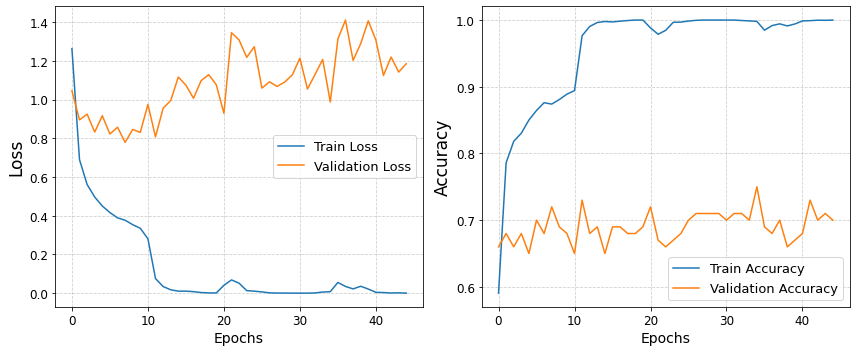

In [9]:
text_convert_plot(text)

In [29]:
def freeze_all_layers(model):
    for param in model.parameters():
        param.requires_grad = False

freeze_all_layers(trained_model[0])
torch.save(trained_model[0], r'C:\Users\urial\BG\AlphaBravo\samples\samples_centered\table_data\final\seven\models\extra\Ui_Unfreeze_ni_aug_new.pth')


In [30]:
mod = trained_model[0]

In [32]:

inter = {'0_5': 0, '5-15': 1, '15-30': 2, '30-40': 3, '40-50': 4, '50-70': 5, '70-90': 6,'90-110': 7,'11-above': 8}
cm,all_preds,all_labels = con(model=mod,data_path=TrainingConfiguration.data_root,
                              file_path='test_index_cat.txt',
                              size=9,mean=TrainingConfiguration.mean,
                              std=TrainingConfiguration.std)



total correct: 279
accuracy: 0.6992481203007519


Confusion matrix, without normalization
tensor([[34,  0,  0,  0,  0,  0,  0,  0,  0],
        [ 0, 68,  3,  0,  0,  0,  0,  0,  2],
        [ 0, 31, 48,  1,  0,  0,  1,  0, 10],
        [ 0,  4,  3, 17,  9,  0,  0,  0,  5],
        [ 0,  0,  0,  5, 25,  2,  1,  1,  1],
        [ 0,  0,  0,  1,  5, 29,  4,  0,  2],
        [ 0,  1,  0,  2,  1,  0,  9, 11,  5],
        [ 0,  0,  0,  0,  0,  0,  1, 41,  3],
        [ 0,  0,  0,  0,  0,  0,  0,  5,  8]])


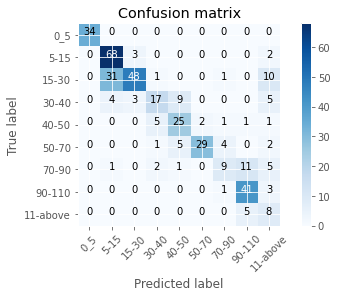

In [37]:

plot_confusion_matrix(cm,classes=inter,ranges=inter);


In [70]:
import numpy as np

confusion_matrix = np.array([[34,  0,  0,  0,  0,  0,  0,  0,  0],
        [ 0, 68,  3,  0,  0,  0,  0,  0,  2],
        [ 0, 31, 48,  1,  0,  0,  1,  0, 10],
        [ 0,  4,  3, 17,  9,  0,  0,  0,  5],
        [ 0,  0,  0,  5, 25,  2,  1,  1,  1],
        [ 0,  0,  0,  1,  5, 29,  4,  0,  2],
        [ 0,  1,  0,  2,  1,  0,  9, 11,  5],
        [ 0,  0,  0,  0,  0,  0,  1, 41,  3],
        [ 0,  0,  0,  0,  0,  0,  0,  5,  8]])
TP = np.diag(confusion_matrix)
TN = np.sum(confusion_matrix) - (np.sum(confusion_matrix, axis=0) + np.sum(confusion_matrix, axis=1) - TP)
FP = np.sum(confusion_matrix, axis=0) - TP
FN = np.sum(confusion_matrix, axis=1) - TP

accuracy = np.sum(TP) / np.sum(confusion_matrix)
precision = TP / (TP + FP)
recall = TP / (TP + FN)
f1_score = 2 * (precision * recall) / (precision + recall)

print("Accuracy:", accuracy)
print("Precision:", precision)
print("Recall:", recall)
print("F1-Score:", f1_score)

micro_precision = np.sum(TP) / (np.sum(TP) + np.sum(FP))
micro_recall = np.sum(TP) / (np.sum(TP) + np.sum(FN))
micro_f1_score = 2 * (micro_precision * micro_recall) / (micro_precision + micro_recall)

macro_precision = np.mean(precision)
macro_recall = np.mean(recall)
macro_f1_score = np.mean(f1_score)

print("Micro-Precision:", micro_precision)
print("Micro-Recall:", micro_recall)
print("Micro F1-Score:", micro_f1_score)

print("Macro-Precision:", macro_precision)
print("Macro-Recall:", macro_recall)
print("Macro F1-Score:", macro_f1_score)

Accuracy: 0.6992481203007519
Precision: [1.         0.65384615 0.88888889 0.65384615 0.625      0.93548387
 0.5625     0.70689655 0.22222222]
Recall: [1.         0.93150685 0.52747253 0.44736842 0.71428571 0.70731707
 0.31034483 0.91111111 0.61538462]
F1-Score: [1.         0.76836158 0.66206897 0.53125    0.66666667 0.80555556
 0.4        0.7961165  0.32653061]
Micro-Precision: 0.6992481203007519
Micro-Recall: 0.6992481203007519
Micro F1-Score: 0.6992481203007519
Macro-Precision: 0.6942982046105888
Macro-Recall: 0.6849767932642895
Macro F1-Score: 0.6618388763066262


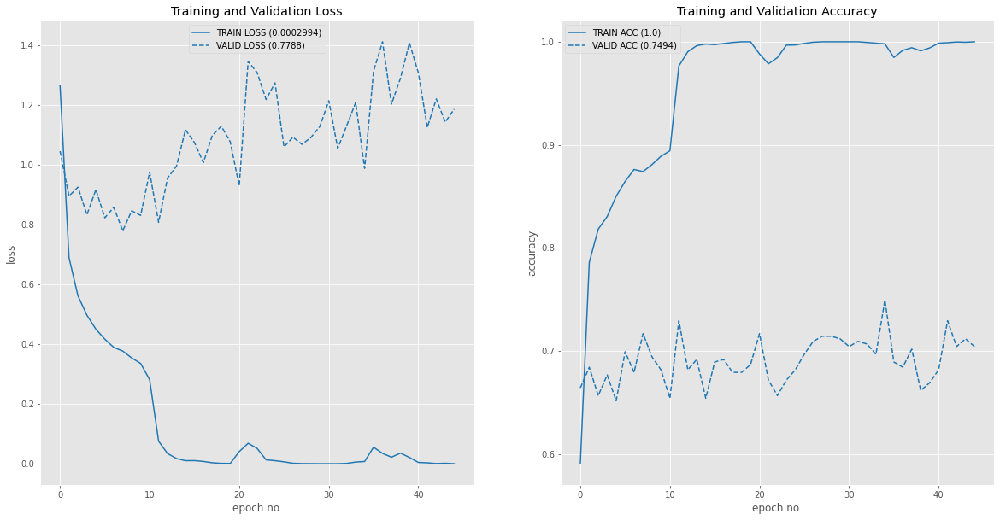

In [40]:

model, epoch_train_loss, epoch_train_acc, epoch_test_loss, epoch_test_acc = trained_model
plot_loss_accuracy([epoch_train_loss],[epoch_test_loss],[epoch_train_acc],[epoch_test_acc]);



In [ ]:
data_root=TrainingConfiguration.data_root#r'C:\Users\urial\BG\AlphaBravo\samples\samples_fixed\fixed\final_samples\data_split\final\validation'
dataset_file = 'test_index.txt'#r'test_index_cat.txt'
mean=TrainingConfiguration.mean
std=TrainingConfiguration.std
imgs,inputs,targets,cls,prob,l = disply_mistakes(model=model,mean= mean, std=std,data_root=data_root,dataset_file=dataset_file)


***

## <font style="color:green">8.2 experiment 3.1 - UnFreeze, no augmentation - expansion</font><a name="step7"></a>
***

In [33]:
# Load the model
model = torch.load(r'C:\Users\urial\BG\AlphaBravo\samples\samples_centered\table_data\final\seven\models\extra\Ui_Unfreeze_ni_aug_new.pth')

optimizer, scheduler = get_optimizer_and_scheduler(model) 
trained_model = main(model, optimizer,scheduler,data_augmentation=False)


Using CUDA
Test set: Average loss: 1.1860, Accuracy: 280/399 (70%)
Initial Test Loss : 1.185974, 
Initial Test Accuracy : 70.175%

set_idx:0,epoch_idx:0
unfreeze: fc
Epoch: 0 
Train Loss: 0.000391 Acc: 1.0000
Elapsed 67.28s, 67.28 s/epoch, 0.95 s/batch, ets 2960.41s
Test set: Average loss: 1.1277, Accuracy: 285/399 (71%)
Model Improved. Saving the Model...

set_idx:0,epoch_idx:1
unfreeze: fc
Epoch: 1 
Train Loss: 0.000199 Acc: 1.0000
Elapsed 134.95s, 67.47 s/epoch, 0.95 s/batch, ets 2901.40s
Test set: Average loss: 1.1157, Accuracy: 287/399 (72%)
Model Improved. Saving the Model...

set_idx:0,epoch_idx:2
unfreeze: fc
Epoch: 2 
Train Loss: 0.000291 Acc: 1.0000
Elapsed 201.25s, 67.08 s/epoch, 0.94 s/batch, ets 2817.55s
Test set: Average loss: 1.1008, Accuracy: 283/399 (71%)
Model Improved. Saving the Model...

set_idx:0,epoch_idx:3
unfreeze: fc
Epoch: 3 
Train Loss: 0.000342 Acc: 1.0000
Elapsed 271.28s, 67.82 s/epoch, 0.96 s/batch, ets 2780.66s
Test set: Average loss: 1.0693, Accuracy: 2

Epoch: 36 
Train Loss: 0.000018 Acc: 1.0000
Elapsed 2617.41s, 70.74 s/epoch, 1.00 s/batch, ets 565.93s
Test set: Average loss: 1.4027, Accuracy: 286/399 (72%)
set_idx:3,epoch_idx:37
unfreeze: fc
unfreeze: layer4
unfreeze: layer3
unfreeze: layer2
Epoch: 37 
Train Loss: 0.000018 Acc: 1.0000
Elapsed 2688.76s, 70.76 s/epoch, 1.00 s/batch, ets 495.30s
Test set: Average loss: 1.4520, Accuracy: 283/399 (71%)
set_idx:3,epoch_idx:38
unfreeze: fc
unfreeze: layer4
unfreeze: layer3
unfreeze: layer2
Epoch: 38 
Train Loss: 0.000013 Acc: 1.0000
Elapsed 2759.20s, 70.75 s/epoch, 1.00 s/batch, ets 424.49s
Test set: Average loss: 1.4343, Accuracy: 285/399 (71%)
set_idx:3,epoch_idx:39
unfreeze: fc
unfreeze: layer4
unfreeze: layer3
unfreeze: layer2
Epoch: 39 
Train Loss: 0.000039 Acc: 1.0000
Elapsed 2830.19s, 70.75 s/epoch, 1.00 s/batch, ets 353.77s
Test set: Average loss: 1.4596, Accuracy: 278/399 (70%)
set_idx:4,epoch_idx:40
unfreeze: fc
unfreeze: layer4
unfreeze: layer3
unfreeze: layer2
Epoch: 40 
Train

In [34]:

def freeze_all_layers(model):
    for param in model.parameters():
        param.requires_grad = False

freeze_all_layers(trained_model[0])
torch.save(trained_model[0], r'C:\Users\urial\BG\AlphaBravo\samples\samples_centered\table_data\final\seven\models\extra\Ui_Unfreeze_ni_aug_new_book.pth')


In [35]:

model_t, epoch_train_loss, epoch_train_acc, epoch_test_loss, epoch_test_acc = trained_model

In [42]:
def plosts(train_loss,val_loss,train_acc,val_acc,points=False):
    epochs = list(range(len(train_loss)))

    # Create a figure with a custom background
    fig, ax = plt.subplots(figsize=(12, 5))
    ax.patch.set_facecolor('#ffffff')  # Set background color for the plot area

    # Plot training and validation loss
    ax1 = plt.subplot(1, 2, 1)
    train_loss_line, = plt.plot(epochs, train_loss, label='Train Loss', linestyle='-', markersize=8)
    val_loss_line, = plt.plot(epochs, val_loss, label='Validation Loss', linestyle='-', markersize=8)
    plt.xlabel('Epochs', fontsize=14)  # Increase font size
    plt.ylabel('Loss', fontsize=17)  # Increase font size
    # plt.title('Training and Validation Loss', fontsize=16)  # Increase font size
    plt.grid(True, linestyle='--', alpha=0.6)  # Add horizontal grid lines


    if points:
            # Mark the minimum validation loss
        min_val_loss_epoch = np.argmin(val_loss)
        min_val_loss = val_loss[min_val_loss_epoch]
        min_train_loss_epoch = np.argmin(train_loss)
        min_train_loss = train_loss[min_train_loss_epoch]
        plt.scatter(min_val_loss_epoch, min_val_loss, color=val_loss_line.get_color(), marker='o', s=100, label=f'Min Val Loss ({min_val_loss:.2f})')
        plt.scatter(min_train_loss_epoch, min_train_loss, color=train_loss_line.get_color(), marker='o', s=100, label=f'Min Train Loss ({min_train_loss:.2f})')
        # Add legend for the points
        legend_loss = ax1.legend(fontsize=12)
#         legend_loss.set_zorder(1)  # Place the legend above the points
    else:
        plt.legend(fontsize=13)
    # Set bigger ticks
    ax1.tick_params(axis='both', which='major', labelsize=12)

    # Plot training and validation accuracy
    ax2 = plt.subplot(1, 2, 2)
    train_acc_line, = plt.plot(epochs, train_acc, label='Train Accuracy', linestyle='-', markersize=8)
    val_acc_line, = plt.plot(epochs, val_acc, label='Validation Accuracy', linestyle='-', markersize=8)
    plt.xlabel('Epochs', fontsize=14)  # Increase font size
    plt.ylabel('Accuracy', fontsize=17)  # Increase font size
    # plt.title('Training and Validation Accuracy', fontsize=16)  # Increase font size
    plt.grid(True, linestyle='--', alpha=0.6)  # Add horizontal grid lines

    if points:
        
        # Mark the maximum validation accuracy
        max_val_acc_epoch = np.argmax(val_acc)
        max_val_acc = val_acc[max_val_acc_epoch]
        max_train_acc_epoch = np.argmax(train_acc)
        max_train_acc = train_acc[max_train_acc_epoch]
        plt.scatter(max_val_acc_epoch, max_val_acc, color=val_acc_line.get_color(), marker='o', s=100, label=f'Max Val Acc ({max_val_acc:.2f})')
        plt.scatter(max_train_acc_epoch, max_train_acc, color=train_acc_line.get_color(), marker='o', s=100, label=f'Max Train Acc ({max_train_acc:.2f})')
        # Add legend for the points
        legend_acc = ax2.legend(fontsize=12)
#         legend_acc.set_zorder(1)  # Place the legend above the points
    else:
        plt.legend(fontsize=13)
    # Set bigger ticks
    ax2.tick_params(axis='both', which='major', labelsize=12)

    plt.tight_layout()
    plt.show()


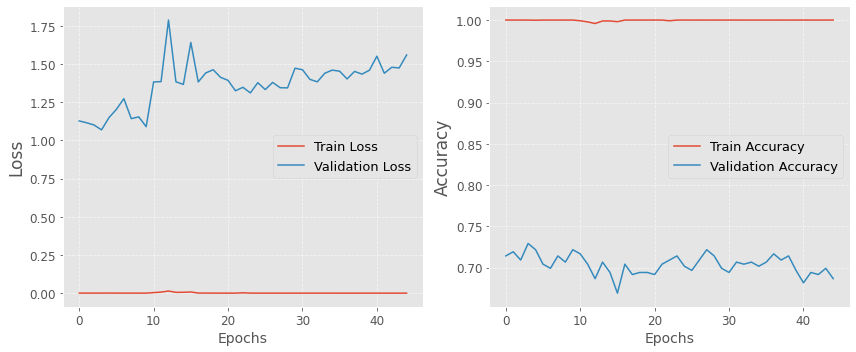

In [43]:

plosts(epoch_train_loss,epoch_test_loss,epoch_train_acc,epoch_test_acc)


In [45]:

inter = {'0_5': 0, '5-15': 1, '15-30': 2, '30-40': 3, '40-50': 4, '50-70': 5, '70-90': 6,'90-110': 7,'11-above': 8}
cm,all_preds,all_labels = con(model=model,data_path=TrainingConfiguration.data_root,
                              file_path='test_index_cat.txt',
                              size=9,mean=TrainingConfiguration.mean,
                              std=TrainingConfiguration.std)


total correct: 276
accuracy: 0.6917293233082706


Confusion matrix, without normalization
tensor([[32,  2,  0,  0,  0,  0,  0,  0,  0],
        [ 0, 70,  2,  0,  0,  0,  0,  0,  2],
        [ 0, 32, 49,  1,  0,  0,  1,  0,  7],
        [ 0,  8,  4, 15,  7,  0,  0,  0,  5],
        [ 0,  0,  0,  2, 23,  1,  3,  1,  2],
        [ 0,  1,  0,  1,  6, 30,  4,  0,  1],
        [ 0,  1,  0,  2,  1,  0,  7,  6,  6],
        [ 0,  0,  0,  0,  0,  0,  0, 41,  8],
        [ 0,  0,  0,  0,  0,  0,  0,  6,  9]])


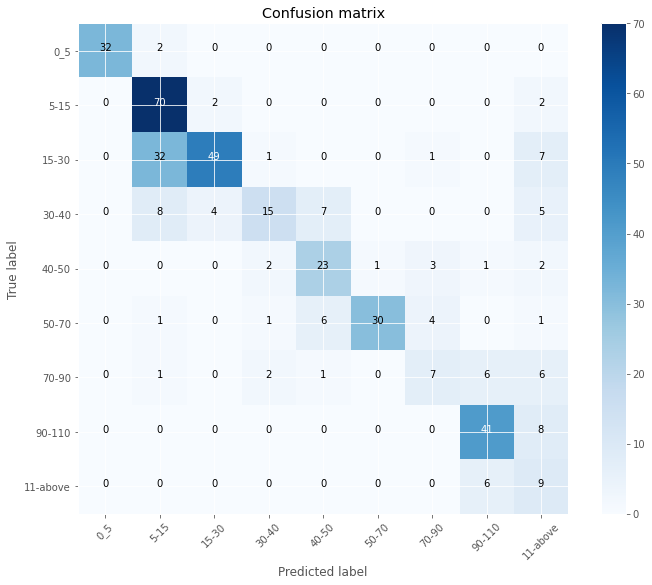

In [52]:

plot_confusion_matrix(cm,classes=inter,ranges=inter);

***

## <font style="color:blue">8.3 experiment 4 - UnFreeze, with augmentations</font><a name="step7"></a>
***

In [74]:

import torch
import torchvision.transforms as transforms
import random

class RandomContrastBrightness(object):
    def __init__(self, contrast_range=(0.15), brightness_range=(0.1)):
        self.contrast_range = contrast_range
        self.brightness_range = brightness_range

    def __call__(self, image):
        transform = transforms.ColorJitter(contrast=self.contrast_range, brightness=self.brightness_range)
        transformed_image = transform(image)
        return transformed_image
# Define the transformations
random_contrast_brightness = RandomContrastBrightness()


import random
import torchvision.transforms as transforms

class RandomTransform_contrast_brightness():
    def __init__(self, p=0.35,contrast_factor = 1.2):
        super(RandomTransform_contrast_brightness, self).__init__()
        self.p = p
        self.contrast_factor = contrast_factor
    def __call__(self, image):
        if random.random() < self.p:
            # Apply random transformation
            transform = random.choice([random_contrast_brightness, transforms.Lambda(lambda img: transforms.functional.adjust_contrast(img, self.contrast_factor))])
            return transform(image)
        else:
            # No transformation
            return image
        
class RandomTransform_sharpen():
    def __init__(self, p=0.35,sharpness = np.random.choice([5.0,10.0,20.0])):
        super(RandomTransform_sharpen, self).__init__()
        self.p = p
        self.sharpness = sharpness
    def __call__(self, image):
        if random.random() < self.p:
            # Apply random transformation
            transform = transforms.Lambda(lambda img: transforms.functional.adjust_sharpness(img, self.sharpness))
            return transform(image)
        else:
            # No transformation
            return image
        
class Random_crop_or_not():
    def __init__(self, p=0.35,crop_size=412):
        super(Random_crop_or_not, self).__init__()
        self.p = p
        self.crop_size = crop_size
    def __call__(self, image):
#         if min(image.shape[1], image.shape[2]) <= self.crop_size :
#             self.crop_size  = min(image.shape[1], image.shape[2])
        
#         if random.random() < self.p:
            # Apply random transformation
#             transform = transforms.Compose([
#                 transforms.RandomCrop(self.crop_size ),
#                 transforms.Resize(224)])
                
        if random.random() < self.p:
            # Apply random transformation
            transform = transforms.Compose([
                transforms.RandomResizedCrop(412, scale=(1.0, 1.0)),#transforms.RandomCrop(412),
                transforms.Resize(224)])
        else:
            # No transformation
            transform = transforms.Compose([
                transforms.Resize(256),
                transforms.CenterCrop(224)])
        return transform(image)
    
class Random_flip():
    def __init__(self, p=0.35):
        super(Random_flip, self).__init__()
        self.p = p

    def __call__(self, image):
        if random.random() < self.p:
            transform= transforms.RandomChoice([
            transforms.RandomHorizontalFlip(),
            transforms.RandomVerticalFlip()])
            return transform(image)
        else:
            # No transformation
            return image   
        
def data_augmentation_preprocess(mean=None, std=None):
    mean=TrainingConfiguration.mean 
    std = TrainingConfiguration.std
    aug_transforms = transforms.Compose([
                 RandomTransform_sharpen(),
                 RandomTransform_contrast_brightness(),
                 Random_flip(),
                 transforms.RandomRotation(180),#RandomTransform(p=0.5),
                Random_crop_or_not(),
                transforms.ToTensor(),
                transforms.Normalize(mean, std)])

    return aug_transforms 

In [42]:
@dataclass
class TrainingConfiguration:
    '''
    Describes configuration of the training process
    '''
    batch_size: int = 64  
    epochs_count: int = 55 
    init_learning_rate: float = 0.001  # initial learning rate for lr scheduler
    learning_rates = [0.0001, 0.00001, 0.000001, 0.000001]
    decay_rate: float = 0.1  
    log_interval: int = 500  
    test_interval: int = 1  
    data_root: str = r'C:\Users\urial\BG\AlphaBravo\samples\samples_fixed\fixed\final_samples\data_split\train_val_change\exp2'#r"C:\Users\urial\BG\AlphaBravo\samples\samples_centered_cat" 
    num_workers: int = 0  
    device: str = 'cuda'  
    train_file: str = r'train_index_cat.txt'
    val_file: str =  r'validation_index_cat.txt'
    model_file_name: str = 'newdf_unfreeze.pt'
    mean: torch.tensor = torch.tensor([0.3670, 0.5109, 0.2689])
    std: torch.tensor = torch.tensor([0.0760, 0.0828, 0.0902])
    custom_loss: bool = False
    weights: bool=True
    get_mean_std: bool=False


In [48]:

model = pretrained_resnet18(num_class=9)
optimizer, scheduler = get_optimizer_and_scheduler(model) 
trained_model = main(model, optimizer,scheduler,data_augmentation=True)

Using CUDA
Test set: Average loss: 2.3052, Accuracy: 34/399 (9%)
Initial Test Loss : 2.305226, 
Initial Test Accuracy : 8.521%

set_idx:0,epoch_idx:0
unfreeze: fc
Epoch: 0 
Train Loss: 2.149928 Acc: 0.1912
Elapsed 163.23s, 163.23 s/epoch, 2.30 s/batch, ets 7182.31s
Test set: Average loss: 2.1041, Accuracy: 84/399 (21%)
Model Improved. Saving the Model...

set_idx:0,epoch_idx:1
unfreeze: fc
Epoch: 1 
Train Loss: 1.901771 Acc: 0.3103
Elapsed 336.64s, 168.32 s/epoch, 2.37 s/batch, ets 7237.76s
Test set: Average loss: 1.8647, Accuracy: 131/399 (33%)
Model Improved. Saving the Model...

set_idx:0,epoch_idx:2
unfreeze: fc
Epoch: 2 
Train Loss: 1.703969 Acc: 0.4224
Elapsed 507.16s, 169.05 s/epoch, 2.38 s/batch, ets 7100.25s
Test set: Average loss: 1.6880, Accuracy: 171/399 (43%)
Model Improved. Saving the Model...

set_idx:0,epoch_idx:3
unfreeze: fc
Epoch: 3 
Train Loss: 1.558982 Acc: 0.4947
Elapsed 680.56s, 170.14 s/epoch, 2.40 s/batch, ets 6975.69s
Test set: Average loss: 1.5536, Accuracy: 

Test set: Average loss: 0.3951, Accuracy: 352/399 (88%)
set_idx:3,epoch_idx:35
unfreeze: fc
unfreeze: layer4
unfreeze: layer3
unfreeze: layer2
Epoch: 35 
Train Loss: 0.101934 Acc: 0.9628
Elapsed 6339.67s, 176.10 s/epoch, 2.48 s/batch, ets 1584.92s
Test set: Average loss: 0.3802, Accuracy: 352/399 (88%)
set_idx:3,epoch_idx:36
unfreeze: fc
unfreeze: layer4
unfreeze: layer3
unfreeze: layer2
Epoch: 36 
Train Loss: 0.107500 Acc: 0.9572
Elapsed 6521.02s, 176.24 s/epoch, 2.48 s/batch, ets 1409.95s
Test set: Average loss: 0.3600, Accuracy: 357/399 (89%)
set_idx:3,epoch_idx:37
unfreeze: fc
unfreeze: layer4
unfreeze: layer3
unfreeze: layer2
Epoch: 37 
Train Loss: 0.103277 Acc: 0.9611
Elapsed 6703.16s, 176.40 s/epoch, 2.48 s/batch, ets 1234.79s
Test set: Average loss: 0.4696, Accuracy: 339/399 (85%)
set_idx:3,epoch_idx:38
unfreeze: fc
unfreeze: layer4
unfreeze: layer3
unfreeze: layer2
Epoch: 38 
Train Loss: 0.097292 Acc: 0.9648
Elapsed 6889.49s, 176.65 s/epoch, 2.49 s/batch, ets 1059.92s
Test set

In [49]:
def freeze_all_layers(model):
    for param in model.parameters():
        param.requires_grad = False

freeze_all_layers(trained_model[0])
torch.save(trained_model[0], r'C:\Users\urial\BG\AlphaBravo\samples\samples_centered\table_data\final\seven\models\extra\Ui_Unfreeze_last.pth')



In [66]:
inter = {'0_5': 0, '5-15': 1, '15-30': 2, '30-40': 3, '40-50': 4, '50-70': 5, '70-90': 6,'90-110': 7,'11-above': 8}
cm,all_preds,all_labels = con(model=trained_model[0],data_path=TrainingConfiguration.data_root,
                              file_path='test_index_cat.txt',
                              size=9,mean=TrainingConfiguration.mean,
                              std=TrainingConfiguration.std)




total correct: 357
accuracy: 0.8947368421052632


Confusion matrix, without normalization
tensor([[34,  0,  0,  0,  0,  0,  0,  0,  0],
        [ 0, 72,  2,  0,  0,  0,  0,  0,  0],
        [ 0,  3, 85,  2,  0,  0,  0,  0,  0],
        [ 0,  0,  5, 32,  2,  0,  0,  0,  0],
        [ 0,  0,  0,  1, 30,  1,  0,  0,  0],
        [ 0,  0,  0,  0,  1, 39,  3,  0,  0],
        [ 0,  0,  0,  0, 10,  0,  8,  3,  2],
        [ 0,  0,  0,  0,  2,  0,  0, 42,  5],
        [ 0,  0,  0,  0,  0,  0,  0,  0, 15]])


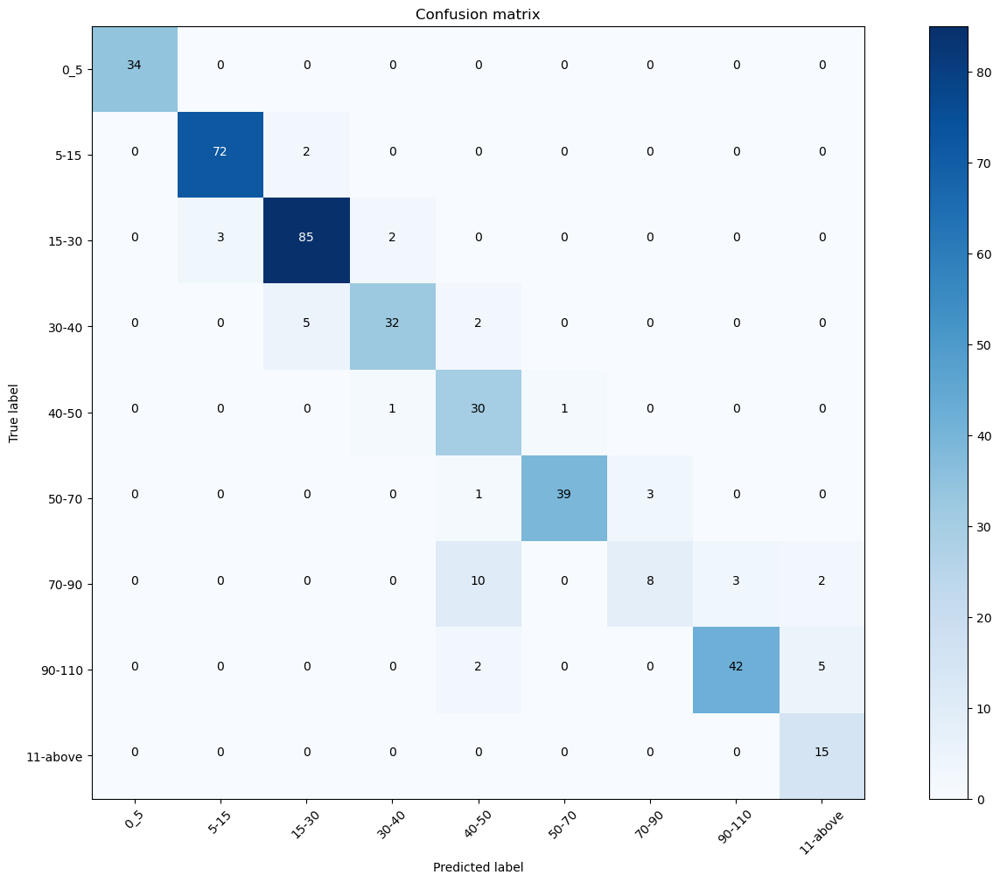

In [68]:
plot_confusion_matrix(cm,classes=inter,ranges=9);


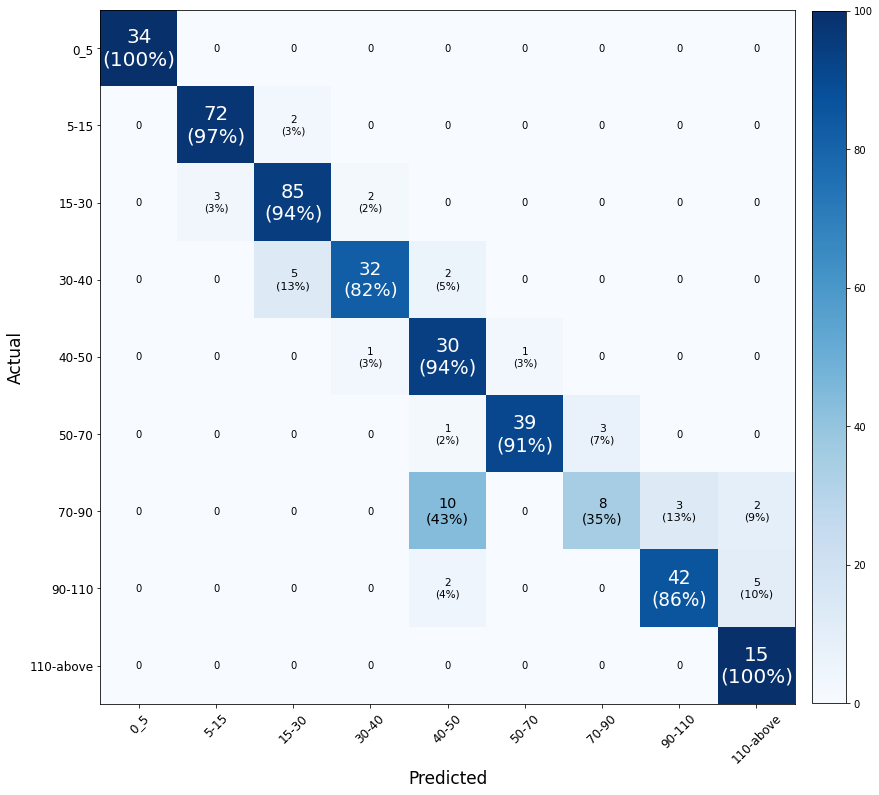

In [11]:

# Given data
confusion_matrix = np.array([[34,  0,  0,  0,  0,  0,  0,  0,  0],
        [ 0, 72,  2,  0,  0,  0,  0,  0,  0],
        [ 0,  3, 85,  2,  0,  0,  0,  0,  0],
        [ 0,  0,  5, 32,  2,  0,  0,  0,  0],
        [ 0,  0,  0,  1, 30,  1,  0,  0,  0],
        [ 0,  0,  0,  0,  1, 39,  3,  0,  0],
        [ 0,  0,  0,  0, 10,  0,  8,  3,  2],
        [ 0,  0,  0,  0,  2,  0,  0, 42,  5],
        [ 0,  0,  0,  0,  0,  0,  0,  0, 15]])
matrix_plot(confusion_matrix)

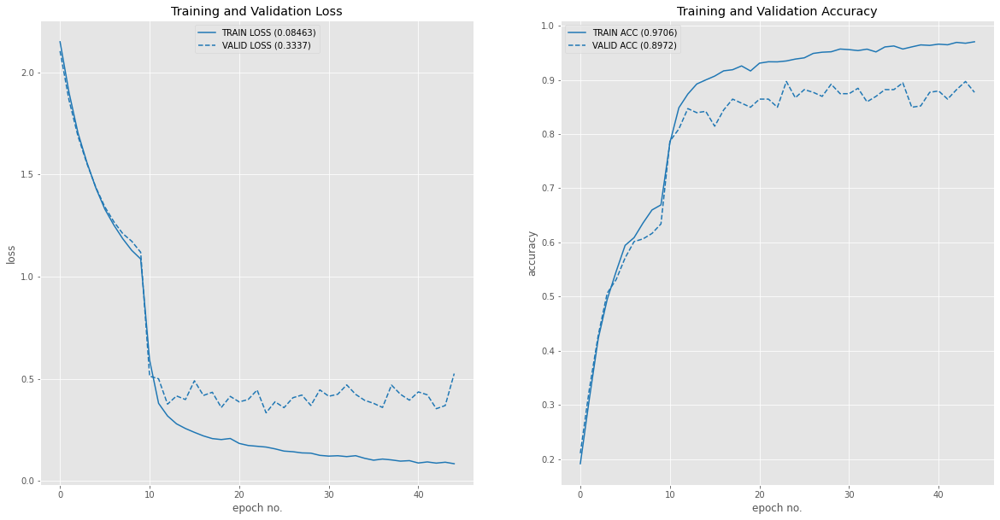

In [52]:
model, epoch_train_loss, epoch_train_acc, epoch_test_loss, epoch_test_acc = trained_model
plot_loss_accuracy([epoch_train_loss],[epoch_test_loss],[epoch_train_acc],[epoch_test_acc]);

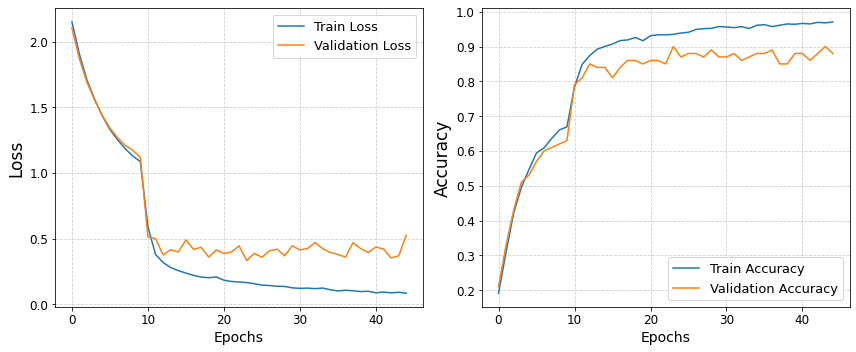

In [12]:

text_convert_plot(text)

In [69]:
import numpy as np

confusion_matrix = np.array([[34,  0,  0,  0,  0,  0,  0,  0,  0],
        [ 0, 72,  2,  0,  0,  0,  0,  0,  0],
        [ 0,  3, 85,  2,  0,  0,  0,  0,  0],
        [ 0,  0,  5, 32,  2,  0,  0,  0,  0],
        [ 0,  0,  0,  1, 30,  1,  0,  0,  0],
        [ 0,  0,  0,  0,  1, 39,  3,  0,  0],
        [ 0,  0,  0,  0, 10,  0,  8,  3,  2],
        [ 0,  0,  0,  0,  2,  0,  0, 42,  5],
        [ 0,  0,  0,  0,  0,  0,  0,  0, 15]])
TP = np.diag(confusion_matrix)
TN = np.sum(confusion_matrix) - (np.sum(confusion_matrix, axis=0) + np.sum(confusion_matrix, axis=1) - TP)
FP = np.sum(confusion_matrix, axis=0) - TP
FN = np.sum(confusion_matrix, axis=1) - TP

accuracy = np.sum(TP) / np.sum(confusion_matrix)
precision = TP / (TP + FP)
recall = TP / (TP + FN)
f1_score = 2 * (precision * recall) / (precision + recall)

print("Accuracy:", accuracy)
print("Precision:", precision)
print("Recall:", recall)
print("F1-Score:", f1_score)

micro_precision = np.sum(TP) / (np.sum(TP) + np.sum(FP))
micro_recall = np.sum(TP) / (np.sum(TP) + np.sum(FN))
micro_f1_score = 2 * (micro_precision * micro_recall) / (micro_precision + micro_recall)

macro_precision = np.mean(precision)
macro_recall = np.mean(recall)
macro_f1_score = np.mean(f1_score)

print("Micro-Precision:", micro_precision)
print("Micro-Recall:", micro_recall)
print("Micro F1-Score:", micro_f1_score)

print("Macro-Precision:", macro_precision)
print("Macro-Recall:", macro_recall)
print("Macro F1-Score:", macro_f1_score)

Accuracy: 0.8947368421052632
Precision: [1.         0.96       0.92391304 0.91428571 0.66666667 0.975
 0.72727273 0.93333333 0.68181818]
Recall: [1.         0.97297297 0.94444444 0.82051282 0.9375     0.90697674
 0.34782609 0.85714286 1.        ]
F1-Score: [1.         0.96644295 0.93406593 0.86486486 0.77922078 0.93975904
 0.47058824 0.89361702 0.81081081]
Micro-Precision: 0.8947368421052632
Micro-Recall: 0.8947368421052632
Micro F1-Score: 0.8947368421052632
Macro-Precision: 0.864698851872765
Macro-Recall: 0.8652639918017404
Macro F1-Score: 0.8510410705219793


***

## <font style="color:blue">8.3 experiment 4.1 - UnFreeze + augmentations expansion</font><a name="step7"></a>
***

In [75]:
# Load the model
model = torch.load( r'C:\Users\urial\BG\AlphaBravo\samples\samples_centered\table_data\final\seven\models\extra\Ui_Unfreeze_last.pth')

optimizer, scheduler = get_optimizer_and_scheduler(model) 
trained_model,epoch_train_loss, epoch_train_acc, epoch_test_loss, epoch_test_acc = main(model, optimizer,scheduler,data_augmentation=True)


Using CUDA
Test set: Average loss: 0.5359, Accuracy: 349/399 (87%)
Initial Test Loss : 0.535921, 
Initial Test Accuracy : 87.469%

set_idx:0,epoch_idx:0
unfreeze: fc
Epoch: 0 
Train Loss: 0.078414 Acc: 0.9714
Elapsed 146.31s, 146.31 s/epoch, 2.06 s/batch, ets 7900.78s
Test set: Average loss: 0.4697, Accuracy: 354/399 (89%)
Model Improved. Saving the Model...

set_idx:0,epoch_idx:1
unfreeze: fc
Epoch: 1 
Train Loss: 0.070509 Acc: 0.9758
Elapsed 290.93s, 145.46 s/epoch, 2.05 s/batch, ets 7709.62s
Test set: Average loss: 0.4727, Accuracy: 352/399 (88%)
set_idx:0,epoch_idx:2
unfreeze: fc
Epoch: 2 
Train Loss: 0.069815 Acc: 0.9771
Elapsed 435.38s, 145.13 s/epoch, 2.04 s/batch, ets 7546.61s
Test set: Average loss: 0.4603, Accuracy: 354/399 (89%)
Model Improved. Saving the Model...

set_idx:0,epoch_idx:3
unfreeze: fc
Epoch: 3 
Train Loss: 0.063918 Acc: 0.9782
Elapsed 576.12s, 144.03 s/epoch, 2.03 s/batch, ets 7345.50s
Test set: Average loss: 0.4362, Accuracy: 352/399 (88%)
Model Improved. Sav

Epoch: 36 
Train Loss: 0.039773 Acc: 0.9859
Elapsed 5222.65s, 141.15 s/epoch, 1.99 s/batch, ets 2540.75s
Test set: Average loss: 0.4967, Accuracy: 351/399 (88%)
set_idx:3,epoch_idx:37
unfreeze: fc
unfreeze: layer4
unfreeze: layer3
unfreeze: layer2
Epoch: 37 
Train Loss: 0.041864 Acc: 0.9842
Elapsed 5366.61s, 141.23 s/epoch, 1.99 s/batch, ets 2400.85s
Test set: Average loss: 0.4495, Accuracy: 351/399 (88%)
set_idx:3,epoch_idx:38
unfreeze: fc
unfreeze: layer4
unfreeze: layer3
unfreeze: layer2
Epoch: 38 
Train Loss: 0.046855 Acc: 0.9838
Elapsed 5513.22s, 141.36 s/epoch, 1.99 s/batch, ets 2261.83s
Test set: Average loss: 0.4487, Accuracy: 354/399 (89%)
set_idx:3,epoch_idx:39
unfreeze: fc
unfreeze: layer4
unfreeze: layer3
unfreeze: layer2
Epoch: 39 
Train Loss: 0.038882 Acc: 0.9864
Elapsed 5654.59s, 141.36 s/epoch, 1.99 s/batch, ets 2120.47s
Test set: Average loss: 0.4296, Accuracy: 352/399 (88%)
set_idx:4,epoch_idx:40
unfreeze: fc
unfreeze: layer4
unfreeze: layer3
unfreeze: layer2
Epoch: 4

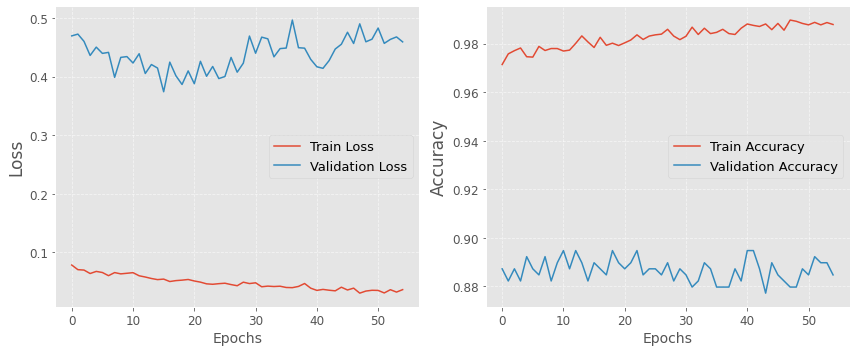

In [76]:
def freeze_all_layers(model):
    for param in model.parameters():
        param.requires_grad = False

freeze_all_layers(trained_model)
torch.save(trained_model, r'C:\Users\urial\BG\AlphaBravo\samples\samples_centered\table_data\final\seven\models\extra\Ui_Unfreeze_ni_aug_new_book.pth')

plosts(epoch_train_loss,epoch_test_loss,epoch_train_acc,epoch_test_acc)


total correct: 363
accuracy: 0.9097744360902256
Confusion matrix, without normalization
tensor([[34,  0,  0,  0,  0,  0,  0,  0,  0],
        [ 0, 73,  1,  0,  0,  0,  0,  0,  0],
        [ 0,  2, 86,  2,  0,  0,  0,  0,  0],
        [ 0,  0,  5, 34,  0,  0,  0,  0,  0],
        [ 0,  0,  0,  1, 31,  0,  0,  0,  0],
        [ 0,  0,  0,  0,  2, 38,  3,  0,  0],
        [ 0,  0,  0,  1,  7,  1,  9,  3,  2],
        [ 0,  0,  2,  0,  0,  0,  0, 44,  3],
        [ 0,  0,  0,  0,  0,  0,  0,  1, 14]])


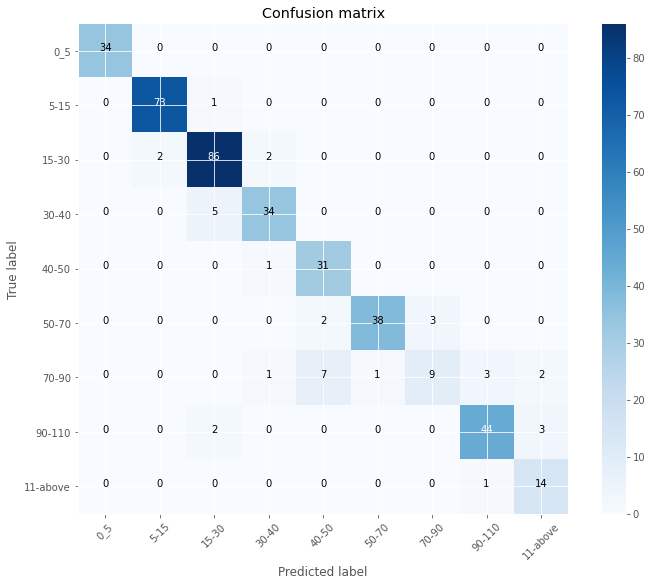

In [77]:
inter = {'0_5': 0, '5-15': 1, '15-30': 2, '30-40': 3, '40-50': 4, '50-70': 5, '70-90': 6,'90-110': 7,'11-above': 8}
cm,all_preds,all_labels = con(model=model,data_path=TrainingConfiguration.data_root,
                              file_path='test_index_cat.txt',
                              size=9,mean=TrainingConfiguration.mean,
                              std=TrainingConfiguration.std)

plot_confusion_matrix(cm,classes=inter,ranges=inter);

ValueError: num must be 1 <= num <= 45, not 46

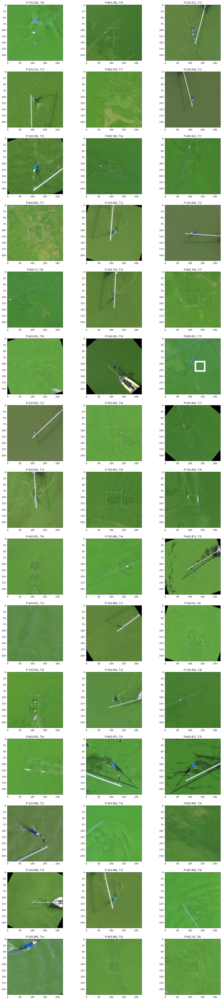

In [63]:
data_root=TrainingConfiguration.data_root#r'C:\Users\urial\BG\AlphaBravo\samples\samples_fixed\fixed\final_samples\data_split\final\validation'
dataset_file = 'test_index_cat.txt'#r'test_index_cat.txt'
mean=TrainingConfiguration.mean
std=TrainingConfiguration.std
imgs,inputs,targets,cls,prob,l = disply_mistakes(model=trained_model[0],mean= mean, std=std,data_root=data_root,dataset_file=dataset_file)


***

### <font style="color:orange">8.2.3 experiment 3 - display mistakes</font><a name="step7"></a>
***

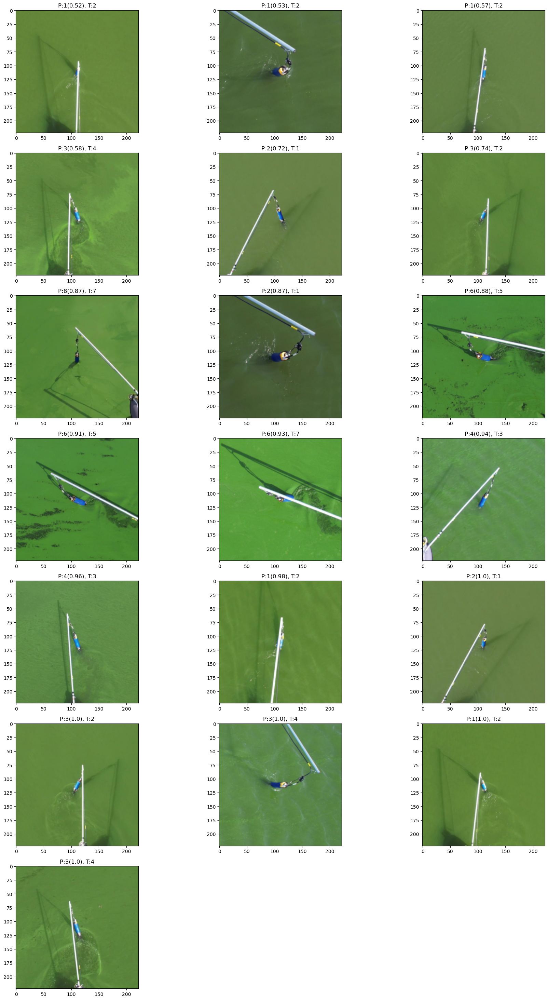

In [182]:

data_root=TrainingConfiguration.data_root
dataset_file = r'test_index_cat.txt'

mean=TrainingConfiguration.mean
std=TrainingConfiguration.std
imgs,inputs,targets,cls,prob,l = disply_mistakes(model=model,mean= mean, std=std,data_root=data_root,dataset_file=dataset_file)


***

### <font style="color:orange">8.2.4 experiment 3 - metrics - HARD test set</font><a name="step7"></a>
***

In [18]:
model_path = r'C:\Users\urial\BG\AlphaBravo\samples\samples_centered\table_data\final\seven\models\extra\Ui_Unfreeze.pth'
# Load the model
model = torch.load(model_path)

# Make sure to set the model to evaluation mode
model.eval()

ResNet(
  (conv1): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
  (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu): ReLU(inplace=True)
  (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
  (layer1): Sequential(
    (0): BasicBlock(
      (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): ReLU(inplace=True)
      (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    )
    (1): BasicBlock(
      (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): ReLU(inplace=True)
  

total correct: 418
accuracy: 0.7491039426523297
{'0_5': 0, '6-15': 1, '16-30': 2, '31-50': 3, '51-70': 4, '71-90': 5, '91-above': 6}
Confusion matrix, without normalization
tensor([[56,  0,  0,  0,  0,  0,  0,  0,  0],
        [ 0, 99,  5,  0,  0,  0,  0,  0,  0],
        [ 0, 44, 60,  1,  0,  0,  0,  0,  3],
        [ 0,  8,  8, 28,  7,  0,  0,  0,  3],
        [ 0,  1,  0,  7, 45,  1,  1,  0,  1],
        [ 0,  0,  0,  0, 19, 26,  0,  0,  0],
        [ 0,  0,  0,  0,  2,  4, 38,  4,  4],
        [ 0,  1,  0,  0,  0,  0,  1, 45, 11],
        [ 0,  1,  0,  0,  0,  0,  0,  3, 21]])


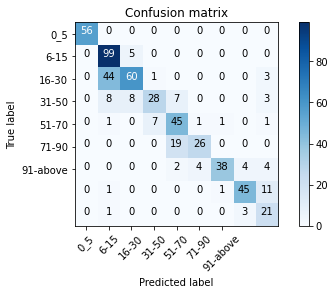

In [23]:
data_path = r'C:\Users\urial\BG\AlphaBravo\samples\samples_fixed\fixed\final_samples\data_split\final\validation'
file_path = r'C:\Users\urial\BG\AlphaBravo\samples\samples_fixed\fixed\final_samples\data_split\final\validation\test_index_cat.txt'
cm,all_preds,all_labels = con(model=model,data_path=data_path,
                              file_path=file_path,
                              size=9,mean=TrainingConfiguration.mean,
                              std=TrainingConfiguration.std)
plot_confusion_matrix(cm)


In [80]:
confusion_matrix=torch.tensor([[56,  0,  0,  0,  0,  0,  0,  0,  0],
        [ 0, 99,  5,  0,  0,  0,  0,  0,  0],
        [ 0, 44, 60,  1,  0,  0,  0,  0,  3],
        [ 0,  8,  8, 28,  7,  0,  0,  0,  3],
        [ 0,  1,  0,  7, 45,  1,  1,  0,  1],
        [ 0,  0,  0,  0, 19, 26,  0,  0,  0],
        [ 0,  0,  0,  0,  2,  4, 38,  4,  4],
        [ 0,  1,  0,  0,  0,  0,  1, 45, 11],
        [ 0,  1,  0,  0,  0,  0,  0,  3, 21]])
scores(confusion_matrix)

Accuracy: 74.91%
Average Precision: 77.79%
Average Recall: 75.04%
F1-Score (macro): 74.40%


***

### <font style="color:orange">8.2.5 experiment 3 - display mistakes - HARD test set</font><a name="step7"></a>
***

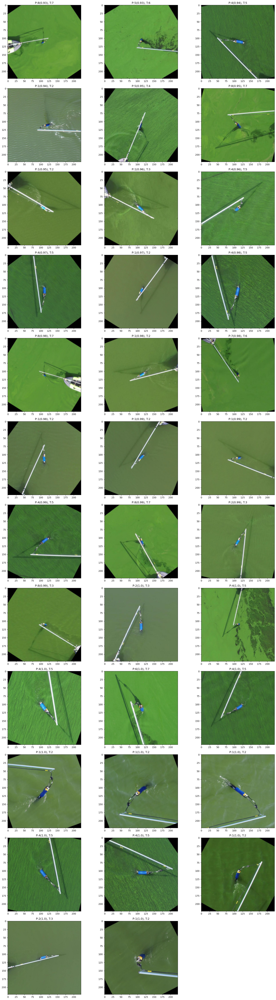

In [25]:

data_root=r'C:\Users\urial\BG\AlphaBravo\samples\samples_fixed\fixed\final_samples\data_split\final\validation'
dataset_file = r'test_index_cat.txt'
mean=TrainingConfiguration.mean
std=TrainingConfiguration.std
imgs,inputs,targets,cls,prob,l = disply_mistakes(model=model,mean= mean, std=std,data_root=data_root,dataset_file=dataset_file)


ValueError: num must be 1 <= num <= 45, not 46

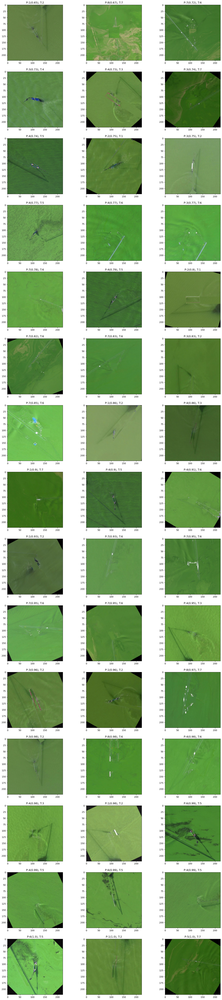

In [63]:
data_root=TrainingConfiguration.data_root#r'C:\Users\urial\BG\AlphaBravo\samples\samples_fixed\fixed\final_samples\data_split\final\validation'
dataset_file = 'test_index.txt'#r'test_index_cat.txt'
mean=TrainingConfiguration.mean
std=TrainingConfiguration.std
imgs,inputs,targets,cls,prob,l = disply_mistakes(model=model,mean= mean, std=std,data_root=data_root,dataset_file=dataset_file)
